FineTuning 10 modelos da Kyoto

Importações

In [1]:
from Modelos import Gerador, cria_modelos, treina_modelos, fine_tuning_modelos, encontrar_modelos_e_pesos,limpa_memoria
from segmentandoDatasets import *
from Preprocessamento import preprocessamento_dataframe


import tensorflow as tf
from keras.layers import Conv2D

2024-11-07 14:48:24.377857: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-07 14:48:24.392118: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-07 14:48:24.396243: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-07 14:48:24.406577: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-11-07 14:48:25.555344: W tensorflow/compiler/tf2

Gerando CSV das bases que vou usar

In [2]:
#segmentacao_PKLot(imagens_treino=500, dias_treino=5, imagens_validacao=100, dias_validaco=1, imagens_teste=200, dias_teste=2)
#segmentacao_CNR(imagens_treino=500, dias_treino=5, imagens_validacao=300, dias_validaco=1, imagens_teste=1000, dias_teste=2)
#segmentacao_PKLot(imagens_treino=500, dias_treino=5, imagens_validacao=100, dias_validaco=1, imagens_teste=200, dias_teste=2, faculdades=["PUC"])
#segmentacao_PKLot(imagens_treino=500, dias_treino=5, imagens_validacao=100, dias_validaco=1, imagens_teste=200, dias_teste=2, faculdades=["UFPR04"])
#segmentacao_PKLot(imagens_treino=500, dias_treino=5, imagens_validacao=100, dias_validaco=1, imagens_teste=200, dias_teste=2, faculdades=["UFPR05"])
#segmentacao_Kyoto()

Preprocessamento das bases

In [3]:
treino_Kyoto, _ = preprocessamento_dataframe(caminho_csv='CSV/Kyoto_Segmentado_Treino.csv', autoencoder=True)
validacao_Kyoto, _ = preprocessamento_dataframe(caminho_csv='CSV/Kyoto_Segmentado_Validacao.csv', autoencoder=True)
teste_Kyoto, _ = preprocessamento_dataframe(caminho_csv='CSV/Kyoto_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 32 validated image filenames.
Found 10 validated image filenames.
Found 20 validated image filenames.


In [4]:
treino_UFPR04, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR04_Segmentado_Treino.csv', autoencoder=True)
validacao_UFPR04, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR04_Segmentado_Validacao.csv', autoencoder=True)
teste_UFPR04, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR04_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 500 validated image filenames.
Found 100 validated image filenames.
Found 200 validated image filenames.


In [5]:
treino_UFPR05, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR05_Segmentado_Treino.csv', autoencoder=True)
validacao_UFPR05, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR05_Segmentado_Validacao.csv', autoencoder=True)
teste_UFPR05, _ = preprocessamento_dataframe(caminho_csv='CSV/UFPR05_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 500 validated image filenames.
Found 100 validated image filenames.
Found 200 validated image filenames.


In [2]:
treino_PUC, _ = preprocessamento_dataframe(caminho_csv='CSV/PUC_Segmentado_Treino.csv', autoencoder=True)
validacao_PUC, _ = preprocessamento_dataframe(caminho_csv='CSV/PUC_Segmentado_Validacao.csv', autoencoder=True)
teste_PUC, _ = preprocessamento_dataframe(caminho_csv='CSV/PUC_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 500 validated image filenames.
Found 100 validated image filenames.
Found 200 validated image filenames.


In [7]:
treino_CNR, _ = preprocessamento_dataframe(caminho_csv='CSV/CNR_Segmentado_Treino.csv', autoencoder=True)
validacao_CNR, _ = preprocessamento_dataframe(caminho_csv='CSV/CNR_Segmentado_Validacao.csv', autoencoder=True)
teste_CNR, _ = preprocessamento_dataframe(caminho_csv='CSV/CNR_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 500 validated image filenames.
Found 300 validated image filenames.
Found 1000 validated image filenames.


In [8]:
treino_PKLot, _ = preprocessamento_dataframe(caminho_csv='CSV/PKLot_Segmentado_Treino.csv', autoencoder=True)
validacao_PKLot, _ = preprocessamento_dataframe(caminho_csv='CSV/PKLot_Segmentado_Validacao.csv', autoencoder=True)
teste_PKLot, _ = preprocessamento_dataframe(caminho_csv='CSV/PKLot_Segmentado_Teste.csv', autoencoder=True, data_algumentantation=False)

Found 500 validated image filenames.
Found 100 validated image filenames.
Found 200 validated image filenames.


Criando e treinando os 10 modelos na base Kyoto

In [11]:
nome_Kyoto = 'Modelo_Kyoto'

In [11]:
#cria_modelos(n_modelos=10, nome_modelo=nome_Kyoto)

I0000 00:00:1730921833.585072  608401 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730921833.767143  608401 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730921833.767498  608401 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730921833.768480  608401 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

<KerasTensor shape=(None, 4096), dtype=float32, sparse=False, name=keras_tensor_8>
<KerasTensor shape=(None, 16, 16, 16), dtype=float32, sparse=False, name=keras_tensor_9>
<KerasTensor shape=(None, 16, 16, 16), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 32, 32, 8), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 64, 64, 8), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_14>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1849)           │     7,576,745 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     7,581,299 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,158,044 (57.82 MB)

 Trainable params: 15,158,044 (57.82 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 8)      │           224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 16)     │         1,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 4096)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1849)           │     7,575,353 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,576,745 (28.90 MB)

 Trainable params: 7,576,745 (28.90 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 1849)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 4096)           │     7,577,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 16, 16, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 16)     │         2,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 8)      │         1,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 64, 64, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │           219 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,581,299 (28.92 MB)

 Trainable params: 7,581,299 (28.92 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 2048), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 8, 8, 32), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 8, 8, 32), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 8, 8, 64), dtype=float32, sparse=False, name=keras_tensor_14>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_15>
<KerasTensor shape=(None, 16, 16, 8), dtype=float32, sparse=False, name=keras_tensor_16>
<KerasTensor shape=(None, 32, 32, 8), dtype=float32, sparse=False, name=keras_tensor_17>
<KerasTensor shape=(None, 32, 32, 32), dtype=float32, sparse=False, name=keras_tensor_18>
<KerasTensor shape=(None, 64, 64, 32), dtype=float32, sparse=False, name=keras_tensor_19>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_20>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 467)            │       983,227 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       994,027 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,977,254 (7.54 MB)

 Trainable params: 1,977,254 (7.54 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 8)      │         2,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 64)     │         4,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 8, 8, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 32)       │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 467)            │       956,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 983,227 (3.75 MB)

 Trainable params: 983,227 (3.75 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 467)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2048)           │       958,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 8, 8, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 8, 8, 64)       │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 16, 16, 8)      │         4,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 32, 32, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 32, 32, 32)     │         2,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_2 (UpSampling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 64, 64, 3)      │           867 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 994,027 (3.79 MB)

 Trainable params: 994,027 (3.79 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 128), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 4, 4, 8), dtype=float32, sparse=False, name=keras_tensor_14>
<KerasTensor shape=(None, 4, 4, 8), dtype=float32, sparse=False, name=keras_tensor_15>
<KerasTensor shape=(None, 8, 8, 8), dtype=float32, sparse=False, name=keras_tensor_16>
<KerasTensor shape=(None, 8, 8, 64), dtype=float32, sparse=False, name=keras_tensor_17>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_18>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_19>
<KerasTensor shape=(None, 32, 32, 64), dtype=float32, sparse=False, name=keras_tensor_20>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_21>
<KerasTensor shape=(None, 64, 64, 16), dtype=float32, sparse=False, name=keras_tensor_22>
<KerasTensor shape=(None, 64, 64, 128), dtype=float32, sparse=False, name=keras_tensor_23>
<KerasTensor shape=(None, 6

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 690)            │       161,866 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       161,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 323,749 (1.24 MB)

 Trainable params: 323,749 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 128)    │         3,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 64, 64, 16)     │        18,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 32, 32, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 8, 8, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 8, 8, 8)        │         4,616 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 4, 4, 8)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 690)            │        89,010 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 161,866 (632.29 KB)

 Trainable params: 161,866 (632.29 KB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 690)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        88,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 4, 4, 8)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 4, 4, 8)        │           584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 8, 8, 8)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 8, 8, 64)       │         4,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_2 (UpSampling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 32, 32, 16)     │         9,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_3 (UpSampling2D)  │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 64, 64, 128)    │        18,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 64, 64, 3)      │         3,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 161,883 (632.36 KB)

 Trainable params: 161,883 (632.36 KB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 2048), dtype=float32, sparse=False, name=keras_tensor_8>
<KerasTensor shape=(None, 16, 16, 8), dtype=float32, sparse=False, name=keras_tensor_9>
<KerasTensor shape=(None, 16, 16, 8), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 32, 32, 8), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 32, 32, 32), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 64, 64, 32), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_14>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1674)           │     3,433,234 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     3,434,187 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,867,421 (26.20 MB)

 Trainable params: 6,867,421 (26.20 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 8)      │         2,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1674)           │     3,430,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,433,234 (13.10 MB)

 Trainable params: 3,433,234 (13.10 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 1674)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2048)           │     3,430,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 16, 16, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 8)      │           584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 32, 32, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 32)     │         2,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │           867 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,434,187 (13.10 MB)

 Trainable params: 3,434,187 (13.10 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 64), dtype=float32, sparse=False, name=keras_tensor_15>
<KerasTensor shape=(None, 2, 2, 16), dtype=float32, sparse=False, name=keras_tensor_16>
<KerasTensor shape=(None, 2, 2, 16), dtype=float32, sparse=False, name=keras_tensor_17>
<KerasTensor shape=(None, 4, 4, 16), dtype=float32, sparse=False, name=keras_tensor_18>
<KerasTensor shape=(None, 4, 4, 64), dtype=float32, sparse=False, name=keras_tensor_19>
<KerasTensor shape=(None, 8, 8, 64), dtype=float32, sparse=False, name=keras_tensor_20>
<KerasTensor shape=(None, 8, 8, 128), dtype=float32, sparse=False, name=keras_tensor_21>
<KerasTensor shape=(None, 16, 16, 128), dtype=float32, sparse=False, name=keras_tensor_22>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_23>
<KerasTensor shape=(None, 32, 32, 64), dtype=float32, sparse=False, name=keras_tensor_24>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_25>
<KerasTensor shape=(None, 32

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 562)            │       213,714 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       215,523 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 429,237 (1.64 MB)

 Trainable params: 429,237 (1.64 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 64)     │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 16)     │         9,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 32, 32, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 8, 8, 64)       │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 4, 4, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 4, 4, 16)       │         9,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 2, 2, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 562)            │        36,530 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 213,714 (834.82 KB)

 Trainable params: 213,714 (834.82 KB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 562)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │        36,032 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 2, 2, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 2, 2, 16)       │         2,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 4, 4, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 4, 4, 64)       │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 8, 8, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 8, 8, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_2 (UpSampling2D)  │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 16, 16, 64)     │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_3 (UpSampling2D)  │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 32, 32, 16)     │         9,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 32, 32, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_4 (UpSampling2D)  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_12 (Conv2D)              │ (None, 64, 64, 3)      │         1,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 215,523 (841.89 KB)

 Trainable params: 215,523 (841.89 KB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 512), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 8, 8, 8), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 8, 8, 8), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 16, 16, 8), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 16, 16, 128), dtype=float32, sparse=False, name=keras_tensor_14>
<KerasTensor shape=(None, 32, 32, 128), dtype=float32, sparse=False, name=keras_tensor_15>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_16>
<KerasTensor shape=(None, 64, 64, 16), dtype=float32, sparse=False, name=keras_tensor_17>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_18>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 685)            │       379,637 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       380,043 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 759,680 (2.90 MB)

 Trainable params: 759,680 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 16)     │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 128)    │        18,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 8)      │         9,224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 8, 8, 8)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 685)            │       351,405 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 379,637 (1.45 MB)

 Trainable params: 379,637 (1.45 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 685)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       351,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 8)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 8)        │           584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 16, 16, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 16, 16, 128)    │         9,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 32, 32, 16)     │        18,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_2 (UpSampling2D)  │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 64, 64, 3)      │           435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 380,043 (1.45 MB)

 Trainable params: 380,043 (1.45 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 16384), dtype=float32, sparse=False, name=keras_tensor_8>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_9>
<KerasTensor shape=(None, 16, 16, 64), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 32, 32, 64), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 64, 64, 16), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_14>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1262)           │    20,687,598 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    20,739,587 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,427,185 (158.03 MB)

 Trainable params: 41,427,185 (158.03 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 16)     │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1262)           │    20,677,870 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,687,598 (78.92 MB)

 Trainable params: 20,687,598 (78.92 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 1262)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 16384)          │    20,692,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 16)     │         9,232 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │           435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,739,587 (79.12 MB)

 Trainable params: 20,739,587 (79.12 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 16384), dtype=float32, sparse=False, name=keras_tensor_8>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_9>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 64, 64, 16), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 64, 64, 32), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 64, 64, 128), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_14>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1960)           │    32,159,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    32,176,435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 64,336,139 (245.42 MB)

 Trainable params: 64,336,139 (245.42 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 128)    │         3,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 64, 64, 32)     │        36,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 64, 64, 16)     │         4,624 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1960)           │    32,114,600 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 32,159,704 (122.68 MB)

 Trainable params: 32,159,704 (122.68 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 1960)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 16384)          │    32,129,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 16)     │         2,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 32)     │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 64, 64, 128)    │        36,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 64, 64, 3)      │         3,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 32,176,435 (122.74 MB)

 Trainable params: 32,176,435 (122.74 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 32768), dtype=float32, sparse=False, name=keras_tensor_8>
<KerasTensor shape=(None, 16, 16, 128), dtype=float32, sparse=False, name=keras_tensor_9>
<KerasTensor shape=(None, 16, 16, 128), dtype=float32, sparse=False, name=keras_tensor_10>
<KerasTensor shape=(None, 32, 32, 128), dtype=float32, sparse=False, name=keras_tensor_11>
<KerasTensor shape=(None, 32, 32, 64), dtype=float32, sparse=False, name=keras_tensor_12>
<KerasTensor shape=(None, 64, 64, 64), dtype=float32, sparse=False, name=keras_tensor_13>
<KerasTensor shape=(None, 64, 64, 3), dtype=float32, sparse=False, name=keras_tensor_14>


Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 838)            │    27,536,070 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    27,715,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,251,529 (210.77 MB)

 Trainable params: 55,251,529 (210.77 MB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 64)     │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 838)            │    27,460,422 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,536,070 (105.04 MB)

 Trainable params: 27,536,070 (105.04 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 838)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 32768)          │    27,492,352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 32, 32, 64)     │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │         1,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,715,459 (105.73 MB)

 Trainable params: 27,715,459 (105.73 MB)

 Non-trainable params: 0 (0.00 B)

<KerasTensor shape=(None, 128), dtype=float32, sparse=False, name=keras_tensor_14>
<KerasTensor shape=(None, 2, 2, 32), dtype=float32, sparse=False, name=keras_tensor_15>
<KerasTensor shape=(None, 2, 2, 32), dtype=float32, sparse=False, name=keras_tensor_16>
<KerasTensor shape=(None, 4, 4, 32), dtype=float32, sparse=False, name=keras_tensor_17>
<KerasTensor shape=(None, 4, 4, 32), dtype=float32, sparse=False, name=keras_tensor_18>
<KerasTensor shape=(None, 8, 8, 32), dtype=float32, sparse=False, name=keras_tensor_19>
<KerasTensor shape=(None, 8, 8, 32), dtype=float32, sparse=False, name=keras_tensor_20>
<KerasTensor shape=(None, 16, 16, 32), dtype=float32, sparse=False, name=keras_tensor_21>
<KerasTensor shape=(None, 16, 16, 8), dtype=float32, sparse=False, name=keras_tensor_22>
<KerasTensor shape=(None, 32, 32, 8), dtype=float32, sparse=False, name=keras_tensor_23>
<KerasTensor shape=(None, 32, 32, 16), dtype=float32, sparse=False, name=keras_tensor_24>
<KerasTensor shape=(None, 64, 6

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 148)            │        41,532 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │        50,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,263 (360.40 KB)

 Trainable params: 92,263 (360.40 KB)

 Non-trainable params: 0 (0.00 B)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 16)     │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 32, 32, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 8)      │         1,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 16, 16, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 32)     │         2,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 8, 8, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 4, 4, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 4, 4, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 2, 2, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 148)            │        19,092 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,532 (162.23 KB)

 Trainable params: 41,532 (162.23 KB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 148)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 2, 2, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 2, 2, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 4, 4, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 4, 4, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_1 (UpSampling2D)  │ (None, 8, 8, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 8, 8, 32)       │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_2 (UpSampling2D)  │ (None, 16, 16, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 16, 16, 8)      │         2,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_3 (UpSampling2D)  │ (None, 32, 32, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 32, 32, 16)     │         1,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_4 (UpSampling2D)  │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 64, 64, 3)      │           435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 50,731 (198.17 KB)

 Trainable params: 50,731 (198.17 KB)

 Non-trainable params: 0 (0.00 B)

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1849)           │     7,576,745 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     7,581,299 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,158,044 (57.82 MB)

 Trainable params: 15,158,044 (57.82 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-0
Epoch 1/200


/home/lucas/PIBIC (copy)/.venv/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1730921844.814295  608471 service.cc:146] XLA service 0x70a56800ec40 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1730921844.814313  608471 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce GTX 1660, Compute Capability 7.5
2024-11-06 16:37:24.859097: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-11-06 16:37:25.060514: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0746

I0000 00:00:1730921847.104471  608471 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.



Epoch 1: val_loss improved from -inf to 0.07440, saving model to Pesos_parciais/weights-improvement-01-0.07.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - loss: 0.0746 - val_loss: 0.0744
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.0759
Epoch 2: val_loss improved from 0.07440 to 0.08515, saving model to Pesos_parciais/weights-improvement-02-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step - loss: 0.0759 - val_loss: 0.0851
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0748
Epoch 3: val_loss did not improve from 0.08515
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0748 - val_loss: 0.0774
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0704
Epoch 4: val_loss improved from 0.08515 to 0.08887, saving model to Pesos_parciais/weights-improvement-04-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step - loss: 0.0704 - val_loss: 0.0889
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 0.0633
Epoch 5: val_loss did not improve from 0.

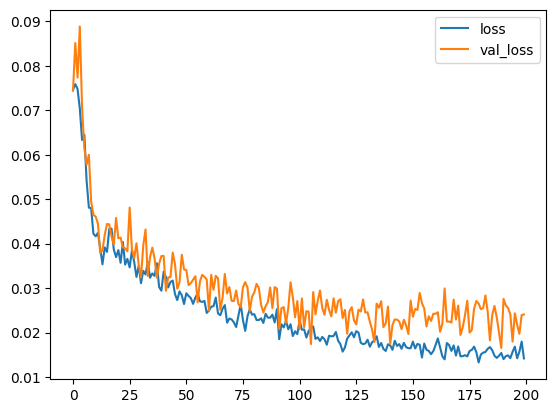

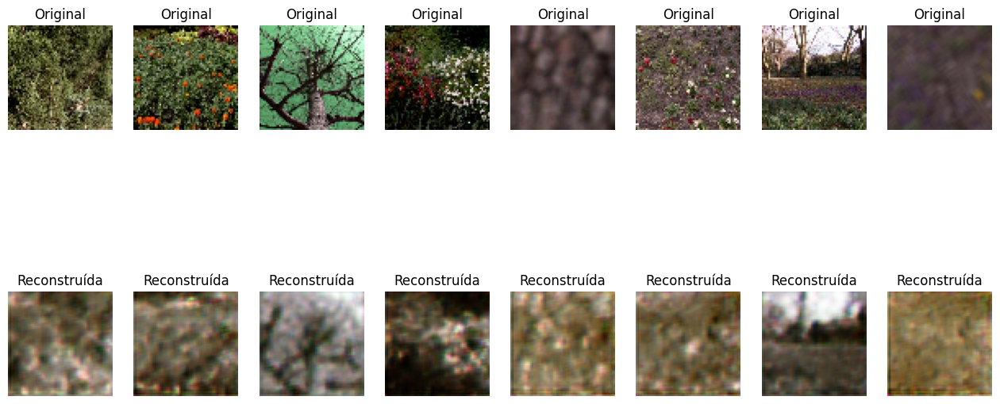

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 467)            │       983,227 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       994,027 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,977,254 (7.54 MB)

 Trainable params: 1,977,254 (7.54 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-1
Epoch 1/200


E0000 00:00:1730921869.596213  608470 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921869.714235  608470 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0745
Epoch 1: val_loss improved from -inf to 0.08156, saving model to Pesos_parciais/weights-improvement-01-0.08.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step - loss: 0.0745 - val_loss: 0.0816
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 0.0795
Epoch 2: val_loss did not improve from 0.08156
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0795 - val_loss: 0.0771
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0717
Epoch 3: val_loss did not improve from 0.08156
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0717 - val_loss: 0.0785
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0667
Epoch 4: val_loss did not improve from 0.08156
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0667 - val_loss: 0.0689
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.0523
Epoch 5: val_loss did not improve from 0.08156
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0523 - val_loss: 0.0483
Epoch 6/200
1/1 ━━━━━━━━

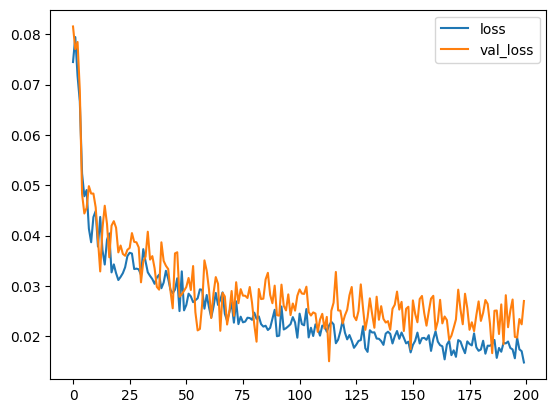

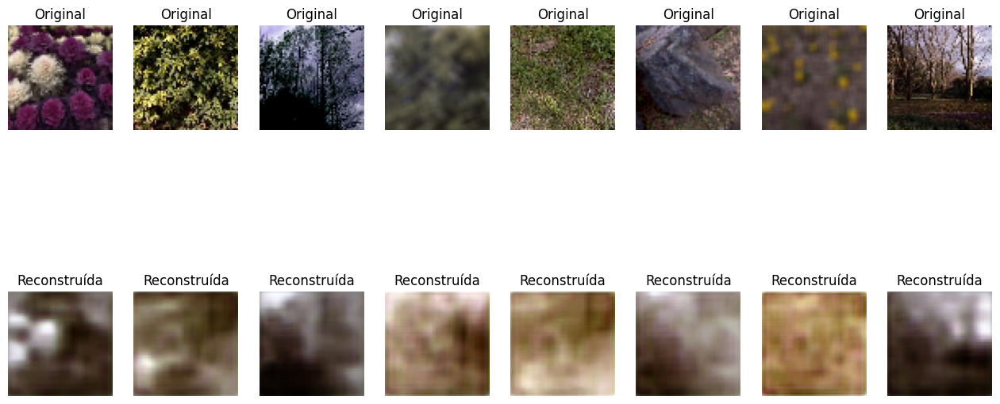

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 690)            │       161,866 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       161,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 323,749 (1.24 MB)

 Trainable params: 323,749 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-2
Epoch 1/200


E0000 00:00:1730921894.758733  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921894.888328  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921895.411835  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921895.554207  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921896.606542  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11s/step - loss: 0.0705
Epoch 1: val_loss improved from -inf to 0.09025, saving model to Pesos_parciais/weights-improvement-01-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step - loss: 0.0705 - val_loss: 0.0902
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0706
Epoch 2: val_loss did not improve from 0.09025
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - loss: 0.0706 - val_loss: 0.0803
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0833
Epoch 3: val_loss did not improve from 0.09025
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.0833 - val_loss: 0.0697
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0711
Epoch 4: val_loss did not improve from 0.09025
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - loss: 0.0711 - val_loss: 0.0764
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0680
Epoch 5: val_loss did not improve from 0.09025
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0680 - val_loss: 0.0827
Epoch 6/200
1/1 ━━━━━

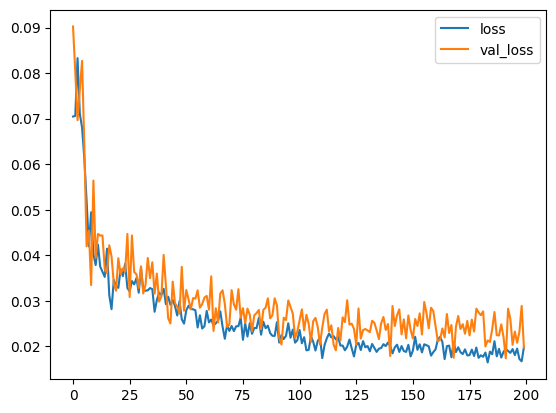

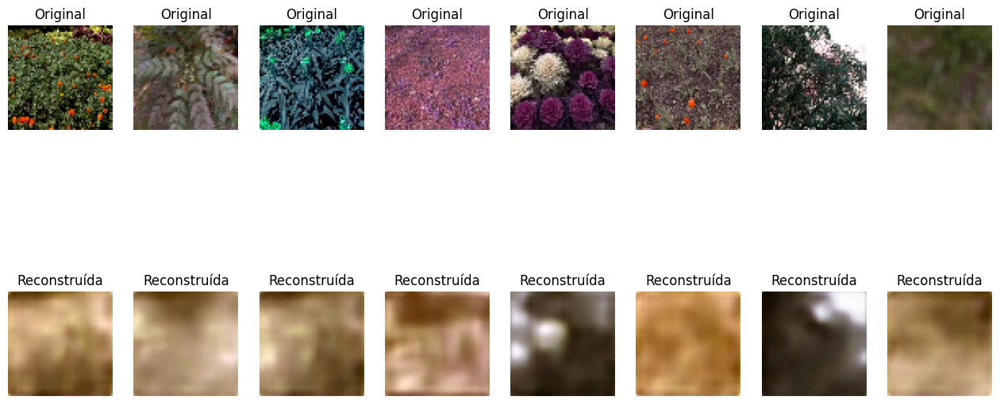

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1674)           │     3,433,234 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     3,434,187 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,867,421 (26.20 MB)

 Trainable params: 6,867,421 (26.20 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-3
Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - loss: 0.0758
Epoch 1: val_loss improved from -inf to 0.08226, saving model to Pesos_parciais/weights-improvement-01-0.08.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - loss: 0.0758 - val_loss: 0.0823
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.0720
Epoch 2: val_loss improved from 0.08226 to 0.08766, saving model to Pesos_parciais/weights-improvement-02-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - loss: 0.0720 - val_loss: 0.0877
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0772
Epoch 3: val_loss improved from 0.08766 to 0.08971, saving model to Pesos_parciais/weights-improvement-03-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - loss: 0.0772 - val_loss: 0.0897
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.0716
Epoch 4: val_loss did not improve from 0.08971
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0716 - val_loss: 0.0829
Epoch 5/

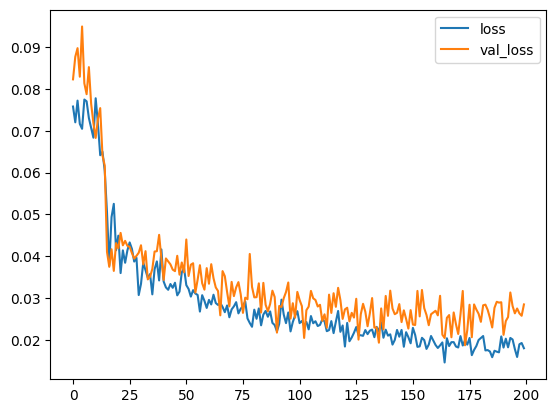

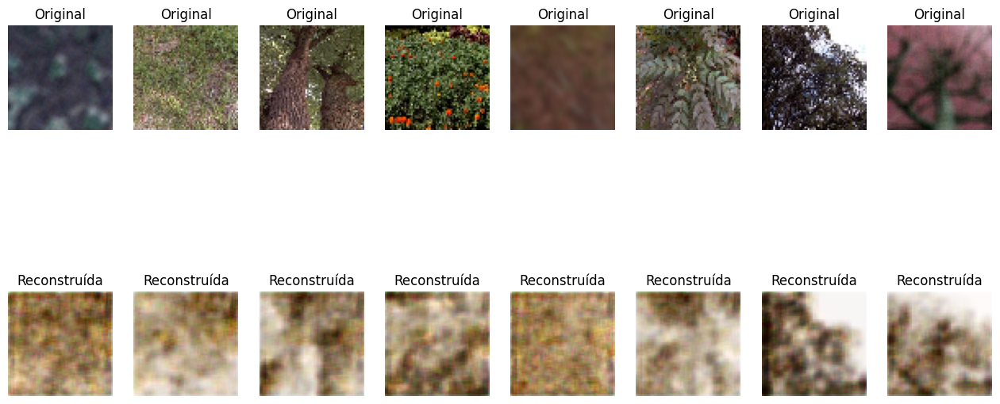

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 562)            │       213,714 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       215,523 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 429,237 (1.64 MB)

 Trainable params: 429,237 (1.64 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-4
Epoch 1/200


E0000 00:00:1730921948.677429  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730921948.800401  608469 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - loss: 0.0747
Epoch 1: val_loss improved from -inf to 0.07363, saving model to Pesos_parciais/weights-improvement-01-0.07.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step - loss: 0.0747 - val_loss: 0.0736
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0722
Epoch 2: val_loss did not improve from 0.07363
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 0.0722 - val_loss: 0.0714
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0765
Epoch 3: val_loss improved from 0.07363 to 0.08916, saving model to Pesos_parciais/weights-improvement-03-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - loss: 0.0765 - val_loss: 0.0892
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0711
Epoch 4: val_loss did not improve from 0.08916
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 0.0711 - val_loss: 0.0747
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.0685
Epoch 5: val_loss did not improve from 0.08916
1/1 ━━━━━━━━━━━━━━

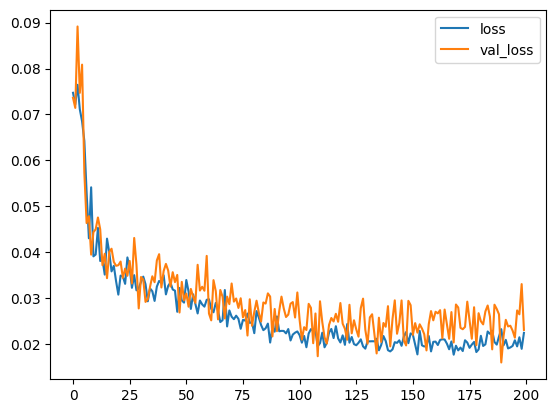

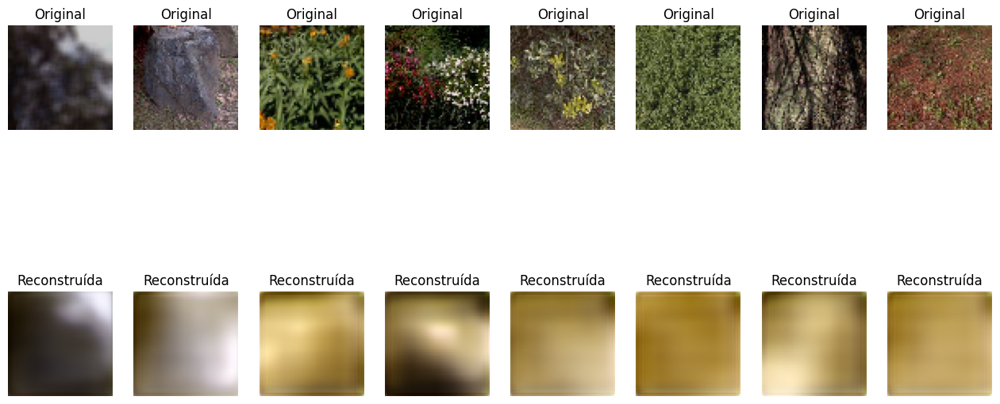

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 685)            │       379,637 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       380,043 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 759,680 (2.90 MB)

 Trainable params: 759,680 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-5
Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0787
Epoch 1: val_loss improved from -inf to 0.08223, saving model to Pesos_parciais/weights-improvement-01-0.08.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step - loss: 0.0787 - val_loss: 0.0822
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0792
Epoch 2: val_loss did not improve from 0.08223
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0792 - val_loss: 0.0791
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.0727
Epoch 3: val_loss did not improve from 0.08223
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - loss: 0.0727 - val_loss: 0.0786
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 0.0777
Epoch 4: val_loss did not improve from 0.08223
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0777 - val_loss: 0.0751
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0758
Epoch 5: val_loss did not improve from 0.08223
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.

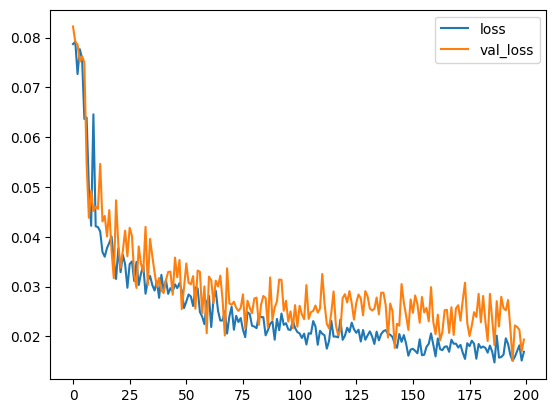

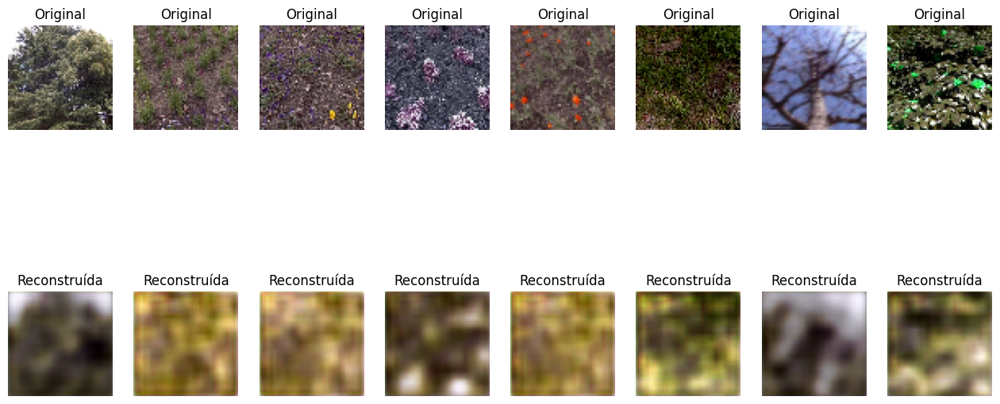

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1262)           │    20,687,598 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    20,739,587 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,427,185 (158.03 MB)

 Trainable params: 41,427,185 (158.03 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-6
Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 0.0765
Epoch 1: val_loss improved from -inf to 0.08336, saving model to Pesos_parciais/weights-improvement-01-0.08.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step - loss: 0.0765 - val_loss: 0.0834
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0683
Epoch 2: val_loss did not improve from 0.08336
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0683 - val_loss: 0.0701
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - loss: 0.0502
Epoch 3: val_loss did not improve from 0.08336
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - loss: 0.0502 - val_loss: 0.0571
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - loss: 0.0612
Epoch 4: val_loss did not improve from 0.08336
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.0612 - val_loss: 0.0605
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0409
Epoch 5: val_loss did not improve from 0.08336
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - loss: 0.

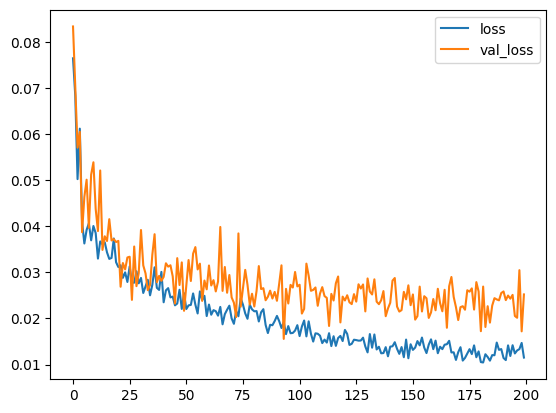

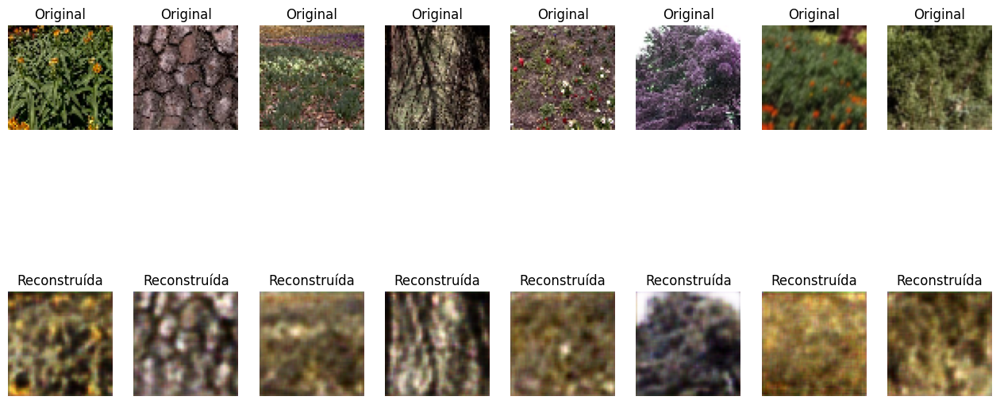

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1960)           │    32,159,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    32,176,435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 64,336,139 (245.42 MB)

 Trainable params: 64,336,139 (245.42 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-7
Epoch 1/200


E0000 00:00:1730922024.139254  608473 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922024.286543  608473 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922024.739296  608473 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922024.861088  608473 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922024.984870  608473 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - loss: 0.0786
Epoch 1: val_loss improved from -inf to 0.08677, saving model to Pesos_parciais/weights-improvement-01-0.09.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step - loss: 0.0786 - val_loss: 0.0868
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - loss: 0.0788
Epoch 2: val_loss did not improve from 0.08677
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0788 - val_loss: 0.0833
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0688
Epoch 3: val_loss did not improve from 0.08677
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - loss: 0.0688 - val_loss: 0.0543
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.0481
Epoch 4: val_loss improved from 0.08677 to 0.09949, saving model to Pesos_parciais/weights-improvement-04-0.10.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 0.0481 - val_loss: 0.0995
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0936
Epoch 5: val_loss did not improve from 0.09949
1/1 ━━━━━━━━━━━━━━

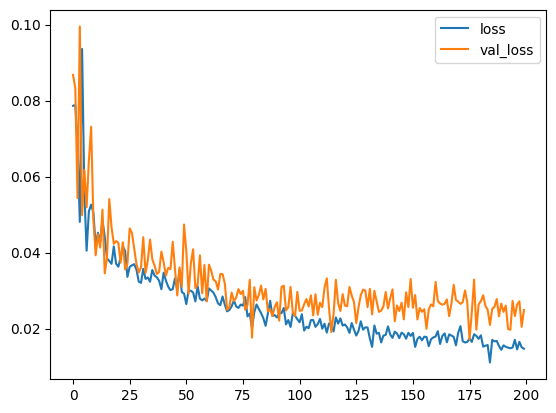

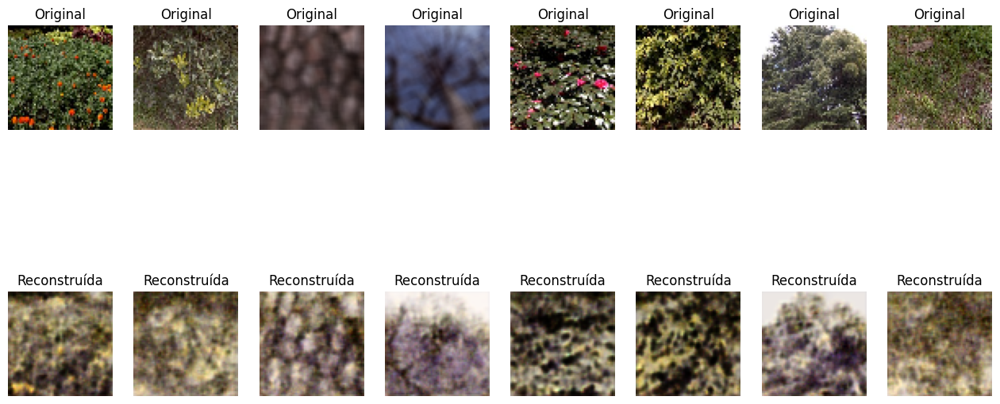

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 838)            │    27,536,070 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    27,715,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,251,529 (210.77 MB)

 Trainable params: 55,251,529 (210.77 MB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-8
Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - loss: 0.0708
Epoch 1: val_loss improved from -inf to 0.07473, saving model to Pesos_parciais/weights-improvement-01-0.07.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step - loss: 0.0708 - val_loss: 0.0747
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0669
Epoch 2: val_loss did not improve from 0.07473
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.0669 - val_loss: 0.0635
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0554
Epoch 3: val_loss did not improve from 0.07473
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0554 - val_loss: 0.0449
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0428
Epoch 4: val_loss did not improve from 0.07473
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0428 - val_loss: 0.0530
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0396
Epoch 5: val_loss did not improve from 0.07473
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.

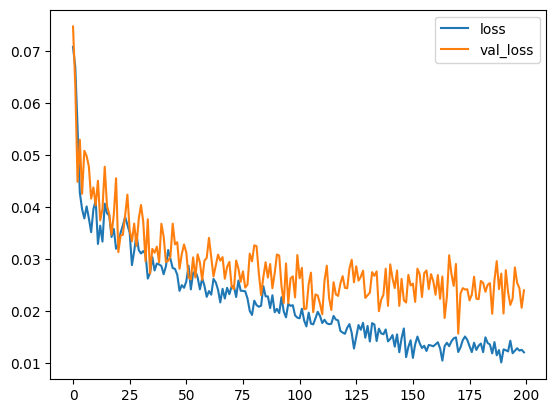

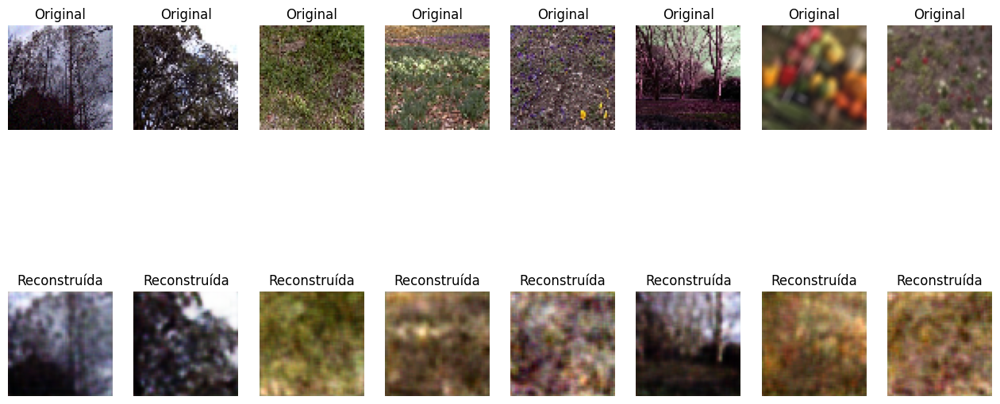

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 148)            │        41,532 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │        50,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,263 (360.40 KB)

 Trainable params: 92,263 (360.40 KB)

 Non-trainable params: 0 (0.00 B)

Treinando o modelo:  Modelo_Kyoto-9
Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - loss: 0.0794
Epoch 1: val_loss improved from -inf to 0.07664, saving model to Pesos_parciais/weights-improvement-01-0.08.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step - loss: 0.0794 - val_loss: 0.0766
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.0748
Epoch 2: val_loss improved from 0.07664 to 0.09846, saving model to Pesos_parciais/weights-improvement-02-0.10.weights.h5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step - loss: 0.0748 - val_loss: 0.0985
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0798
Epoch 3: val_loss did not improve from 0.09846
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0798 - val_loss: 0.0780
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - loss: 0.0715
Epoch 4: val_loss did not improve from 0.09846
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.0715 - val_loss: 0.0765
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0722
Epoch 5: val_loss d

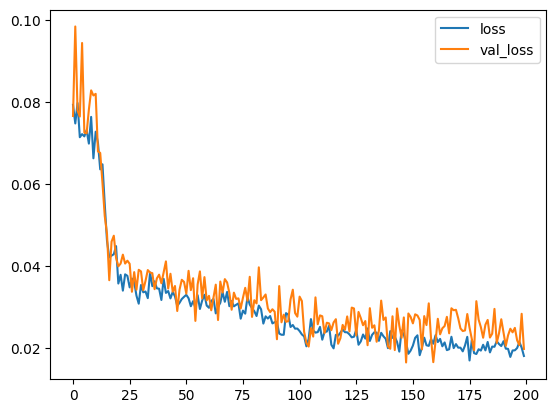

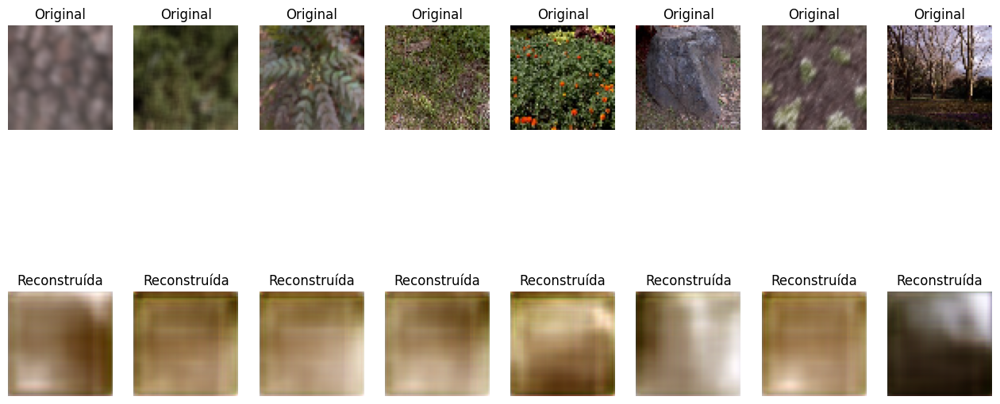

In [12]:
#treina_modelos(treino_Kyoto, validacao_Kyoto, teste_Kyoto, nome_modelo=nome_Kyoto, nome_base='Kyoto', n_epocas=200)

Fine Tuning PUC

I0000 00:00:1730922408.729575  672612 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730922408.834230  672612 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730922408.834438  672612 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730922408.835617  672612 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1849)           │     7,576,745 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     7,581,299 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,158,044 (57.82 MB)

 Trainable params: 15,158,044 (57.82 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


/home/lucas/PIBIC (copy)/.venv/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1730922411.748960  672733 service.cc:146] XLA service 0x7fd1c800acc0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1730922411.748983  672733 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce GTX 1660, Compute Capability 7.5
2024-11-06 16:46:51.809788: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-11-06 16:46:51.976375: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907


 7/16 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0296

I0000 00:00:1730922414.001255  672733 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


11/16 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - loss: 0.0280
Epoch 1: val_loss improved from -inf to 0.02504, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 353ms/step - loss: 0.0269 - val_loss: 0.0250
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0242
Epoch 2: val_loss did not improve from 0.02504
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0241 - val_loss: 0.0234
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0228
Epoch 3: val_loss did not improve from 0.02504
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0228 - val_loss: 0.0250
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0221
Epoch 4: val_loss did not improve from 0.02504
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0221 - val_loss: 0.0238
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0203
Epoch 5: val_loss did not improve from 0.02504
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0203 - val_loss: 0.0219
Ep

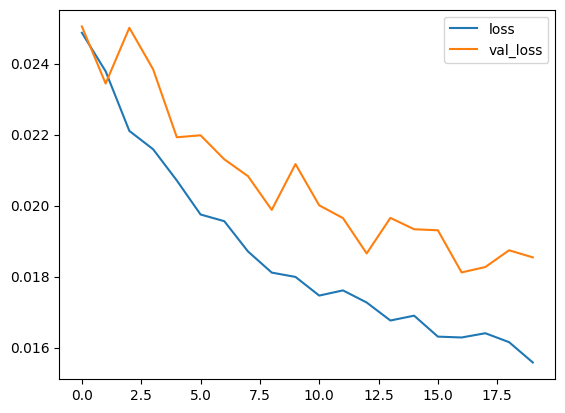

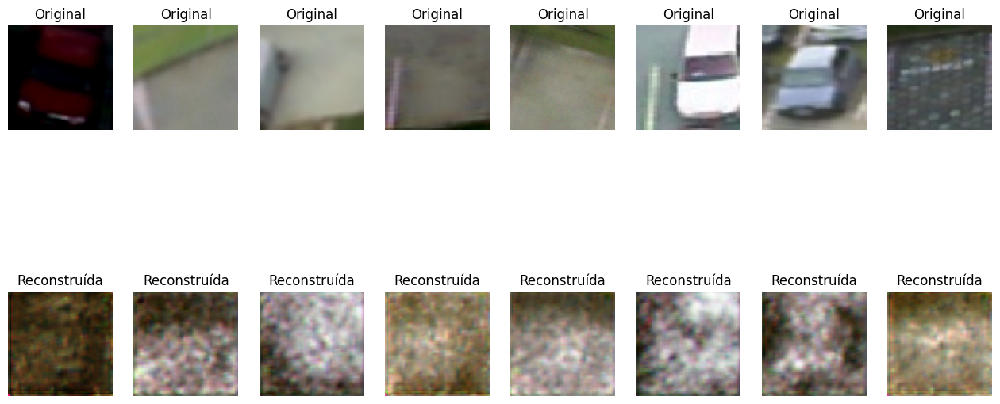

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 467)            │       983,227 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       994,027 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,977,254 (7.54 MB)

 Trainable params: 1,977,254 (7.54 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730922433.089768  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922433.208999  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922433.329837  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 8/16 ━━━━━━━━━━━━━━━━━━━━ 2s 342ms/step - loss: 0.0322
Epoch 1: val_loss improved from -inf to 0.02816, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 11s 339ms/step - loss: 0.0312 - val_loss: 0.0282
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0280
Epoch 2: val_loss did not improve from 0.02816
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0270 - val_loss: 0.0265
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0239
Epoch 3: val_loss did not improve from 0.02816
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0245 - val_loss: 0.0253
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0229
Epoch 4: val_loss did not improve from 0.02816
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0232 - val_loss: 0.0244
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0229
Epoch 5: val_loss did not improve from 0.02816
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0226 - val_loss: 0.0230
E

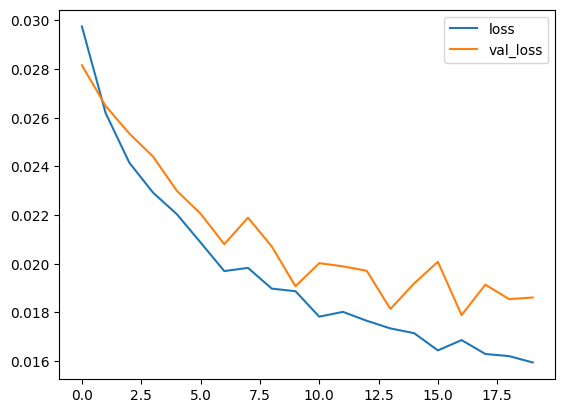

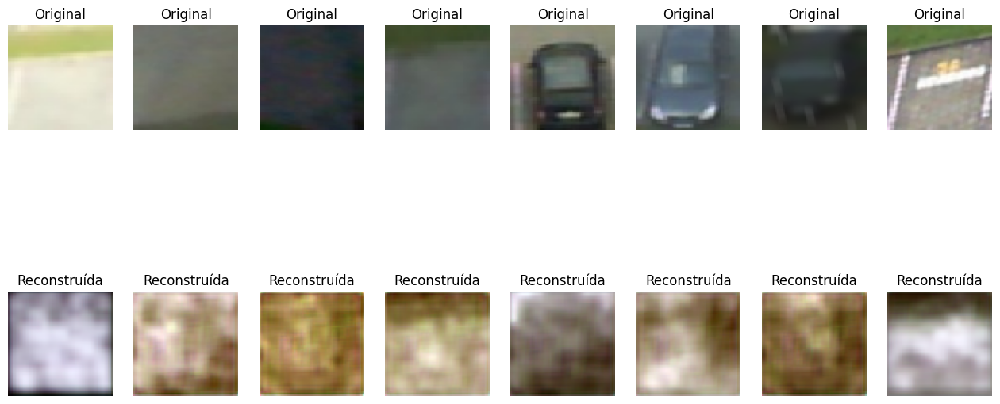

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 690)            │       161,866 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       161,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 323,749 (1.24 MB)

 Trainable params: 323,749 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730922454.028239  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922454.157716  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922454.792114  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922454.934437  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922455.075375  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 1/16 ━━━━━━━━━━━━━━━━━━━━ 2:04 8s/step - loss: 0.0360

E0000 00:00:1730922459.076418  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922459.213714  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


13/16 ━━━━━━━━━━━━━━━━━━━━ 1s 371ms/step - loss: 0.0306
Epoch 1: val_loss improved from -inf to 0.03107, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 461ms/step - loss: 0.0302 - val_loss: 0.0311
Epoch 2/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0252
Epoch 2: val_loss did not improve from 0.03107
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0253 - val_loss: 0.0273
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0254
Epoch 3: val_loss did not improve from 0.03107
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0253 - val_loss: 0.0254
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0230
Epoch 4: val_loss did not improve from 0.03107
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0230 - val_loss: 0.0270
Epoch 5/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0214
Epoch 5: val_loss did not improve from 0.03107
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0215 - val_loss: 0.0236
E

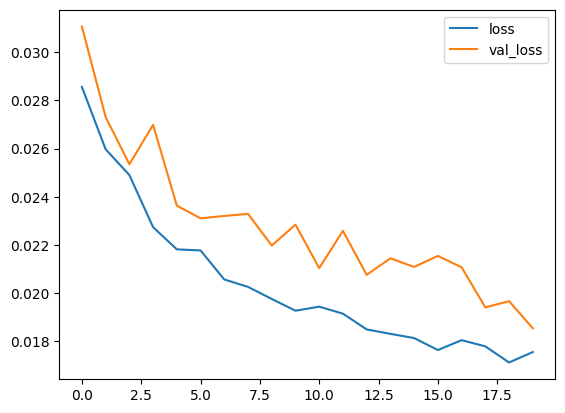

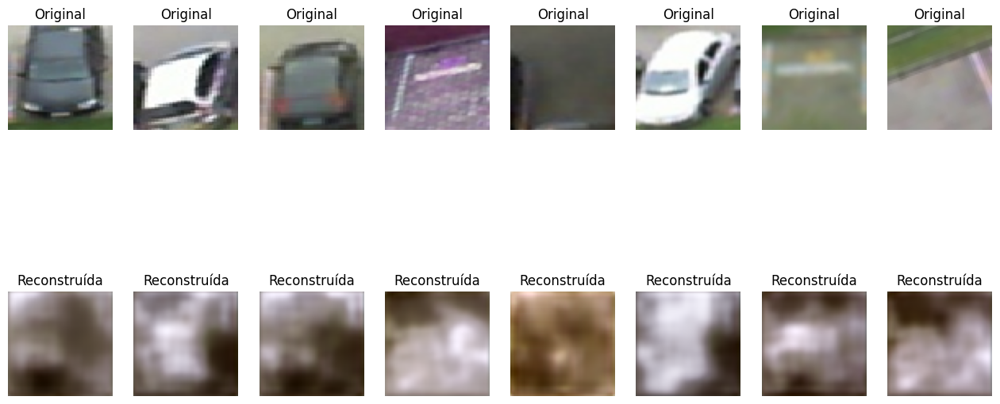

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1674)           │     3,433,234 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     3,434,187 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,867,421 (26.20 MB)

 Trainable params: 6,867,421 (26.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
12/16 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - loss: 0.0393
Epoch 1: val_loss improved from -inf to 0.03917, saving model to Pesos_parciais/weights-improvement-01-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 5s 183ms/step - loss: 0.0386 - val_loss: 0.0392
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0315
Epoch 2: val_loss improved from 0.03917 to 0.03932, saving model to Pesos_parciais/weights-improvement-02-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0334 - val_loss: 0.0393
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0390
Epoch 3: val_loss improved from 0.03932 to 0.04088, saving model to Pesos_parciais/weights-improvement-03-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0382 - val_loss: 0.0409
Epoch 4/20
10/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0348
Epoch 4: val_loss improved from 0.04088 to 0.04123, saving model to Pesos_parciais/weights-improvement-04-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 

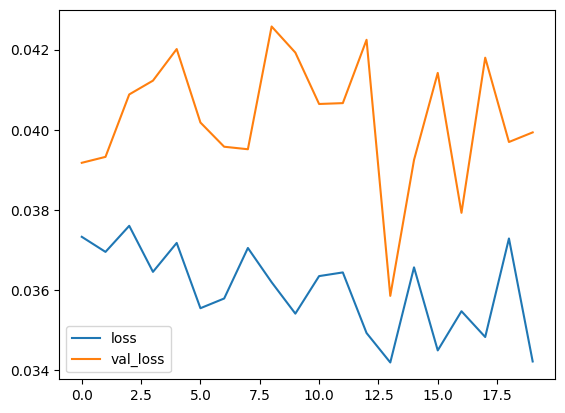

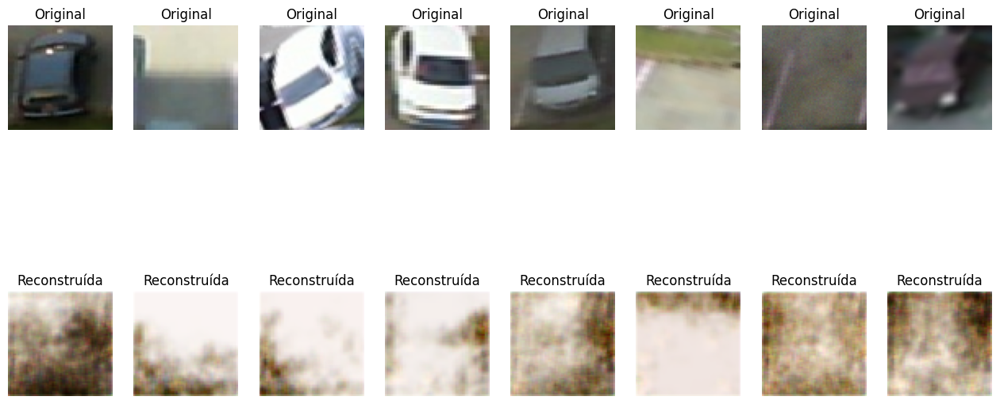

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 562)            │       213,714 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       215,523 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 429,237 (1.64 MB)

 Trainable params: 429,237 (1.64 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730922494.548452  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922494.671420  672733 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - loss: 0.0316
Epoch 1: val_loss improved from -inf to 0.02896, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 357ms/step - loss: 0.0312 - val_loss: 0.0290
Epoch 2/20
11/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0288
Epoch 2: val_loss did not improve from 0.02896
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0278 - val_loss: 0.0265
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0230
Epoch 3: val_loss did not improve from 0.02896
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0231 - val_loss: 0.0258
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0220
Epoch 4: val_loss did not improve from 0.02896
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0221 - val_loss: 0.0243
Epoch 5/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0224
Epoch 5: val_loss did not improve from 0.02896
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0225 - val_loss: 0.0255
E

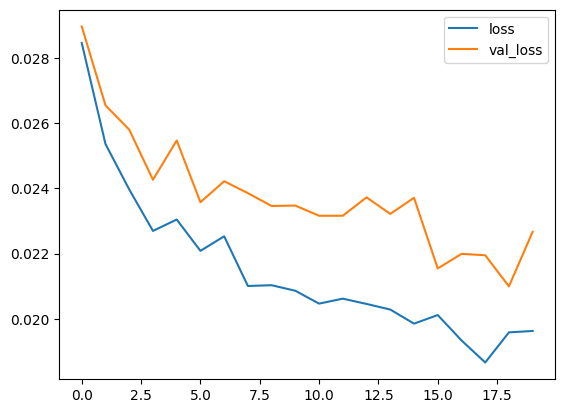

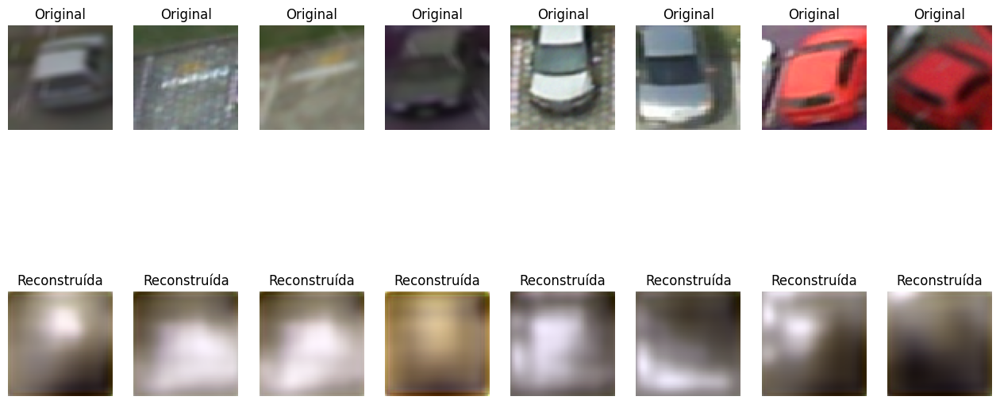

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 685)            │       379,637 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       380,043 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 759,680 (2.90 MB)

 Trainable params: 759,680 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
11/16 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - loss: 0.0230
Epoch 1: val_loss improved from -inf to 0.02443, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 8s 242ms/step - loss: 0.0228 - val_loss: 0.0244
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0207
Epoch 2: val_loss did not improve from 0.02443
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0204 - val_loss: 0.0217
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0188
Epoch 3: val_loss did not improve from 0.02443
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0195 - val_loss: 0.0213
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0191
Epoch 4: val_loss did not improve from 0.02443
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0191 - val_loss: 0.0213
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0198
Epoch 5: val_loss did not improve from 0.02443
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0193 - val_loss

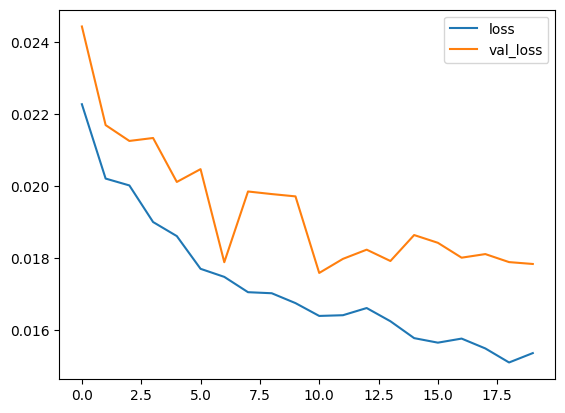

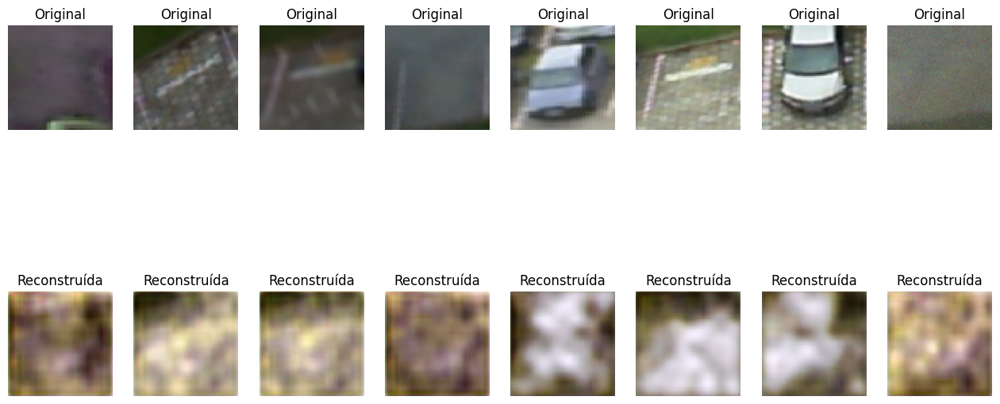

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1262)           │    20,687,598 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    20,739,587 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,427,185 (158.03 MB)

 Trainable params: 41,427,185 (158.03 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step - loss: 0.0242
Epoch 1: val_loss improved from -inf to 0.02223, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 8s 353ms/step - loss: 0.0240 - val_loss: 0.0222
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0211
Epoch 2: val_loss did not improve from 0.02223
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0210 - val_loss: 0.0212
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0185
Epoch 3: val_loss did not improve from 0.02223
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0185 - val_loss: 0.0192
Epoch 4/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0182
Epoch 4: val_loss did not improve from 0.02223
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0181 - val_loss: 0.0200
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0177
Epoch 5: val_loss did not improve from 0.02223
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0177 - val_loss

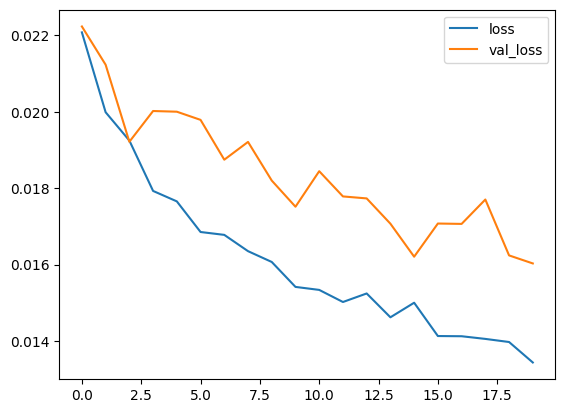

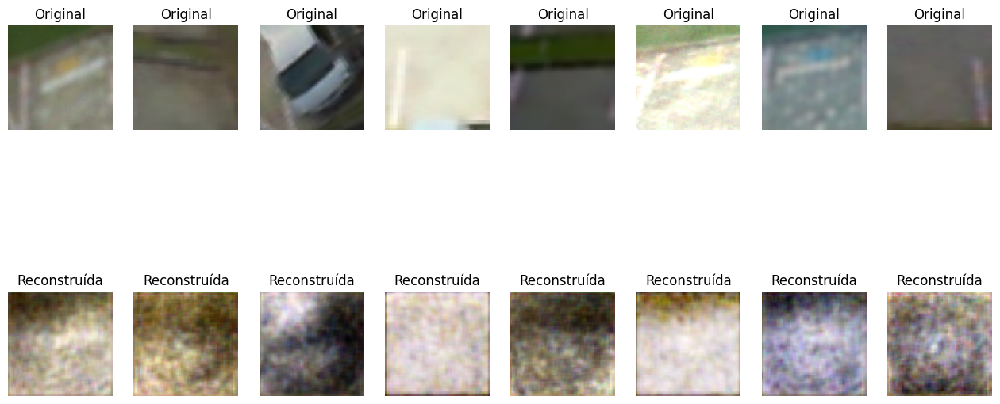

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1960)           │    32,159,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    32,176,435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 64,336,139 (245.42 MB)

 Trainable params: 64,336,139 (245.42 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730922553.486912  672730 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922553.635768  672730 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922554.130552  672730 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922554.252692  672730 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 3/16 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0334

E0000 00:00:1730922557.180129  672734 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730922557.322189  672734 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - loss: 0.0358
Epoch 1: val_loss improved from -inf to 0.03649, saving model to Pesos_parciais/weights-improvement-01-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 20s 975ms/step - loss: 0.0358 - val_loss: 0.0365
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0358
Epoch 2: val_loss improved from 0.03649 to 0.03792, saving model to Pesos_parciais/weights-improvement-02-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 935ms/step - loss: 0.0357 - val_loss: 0.0379
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0294
Epoch 3: val_loss did not improve from 0.03792
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0297 - val_loss: 0.0368
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0313
Epoch 4: val_loss did not improve from 0.03792
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 0.0313 - val_loss: 0.0325
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0328
Epoch 5: val_loss did not improve from 0.0379

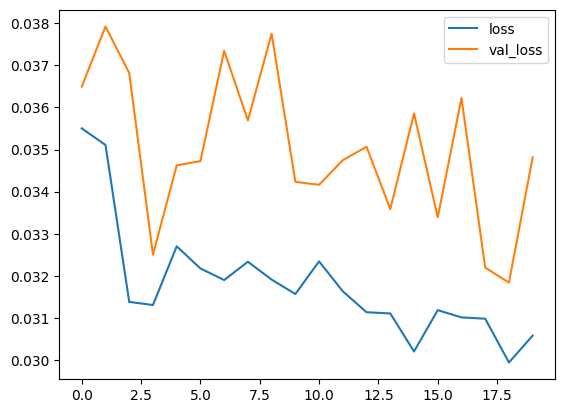

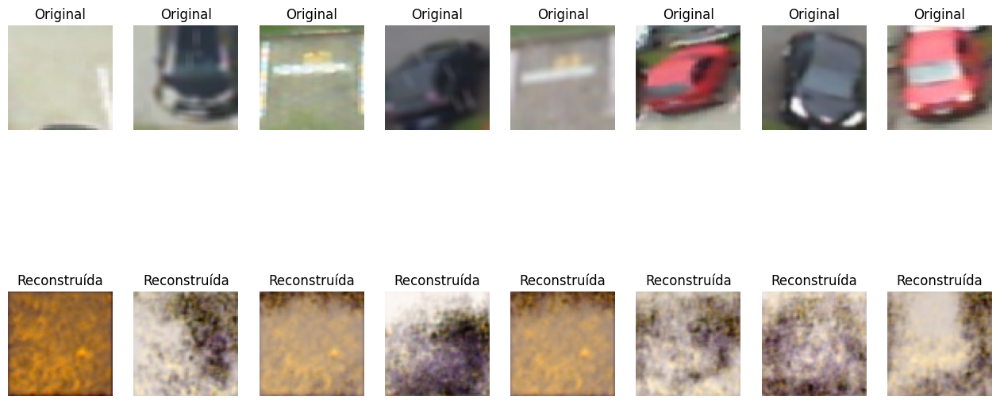

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 838)            │    27,536,070 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    27,715,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,251,529 (210.77 MB)

 Trainable params: 55,251,529 (210.77 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - loss: 0.0244
Epoch 1: val_loss improved from -inf to 0.02326, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 67s 4s/step - loss: 0.0243 - val_loss: 0.0233
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0226
Epoch 2: val_loss did not improve from 0.02326
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0224 - val_loss: 0.0215
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0198
Epoch 3: val_loss did not improve from 0.02326
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - loss: 0.0198 - val_loss: 0.0211
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0193
Epoch 4: val_loss did not improve from 0.02326
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0193 - val_loss: 0.0205
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0178
Epoch 5: val_loss did not improve from 0.02326
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0178 - val_loss: 

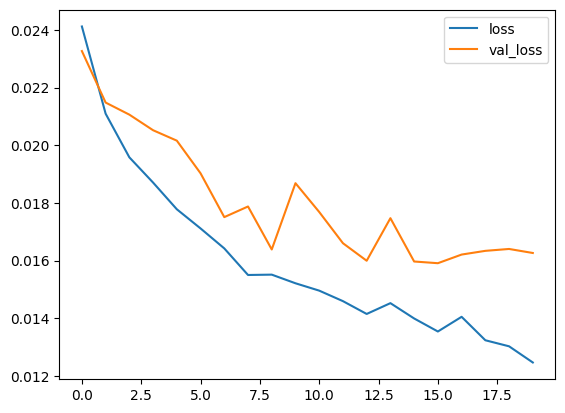

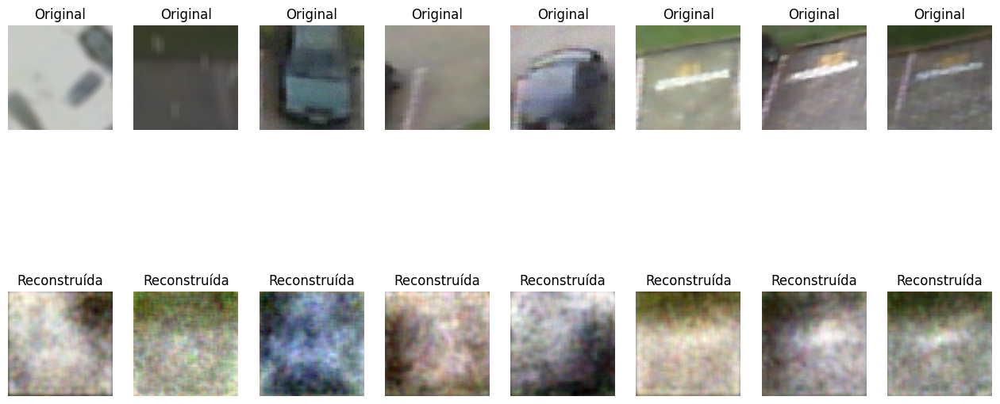

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 148)            │        41,532 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │        50,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,263 (360.40 KB)

 Trainable params: 92,263 (360.40 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 1s 269ms/step - loss: 0.0346
Epoch 1: val_loss improved from -inf to 0.03045, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 11s 364ms/step - loss: 0.0338 - val_loss: 0.0305
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0296
Epoch 2: val_loss improved from 0.03045 to 0.03142, saving model to Pesos_parciais/weights-improvement-02-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - loss: 0.0295 - val_loss: 0.0314
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0286
Epoch 3: val_loss did not improve from 0.03142
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0282 - val_loss: 0.0304
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0260
Epoch 4: val_loss did not improve from 0.03142
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0265 - val_loss: 0.0293
Epoch 5/20
12/16 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0258
Epoch 5: val_loss did not improve fr

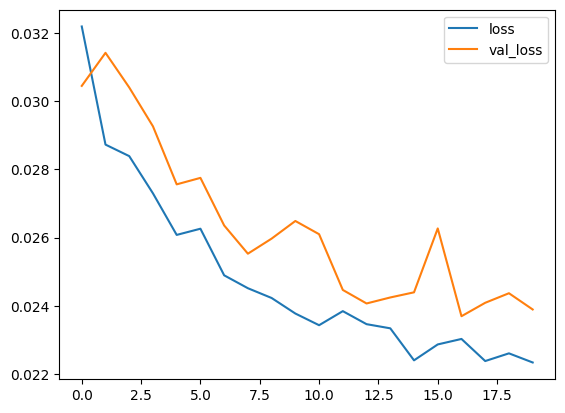

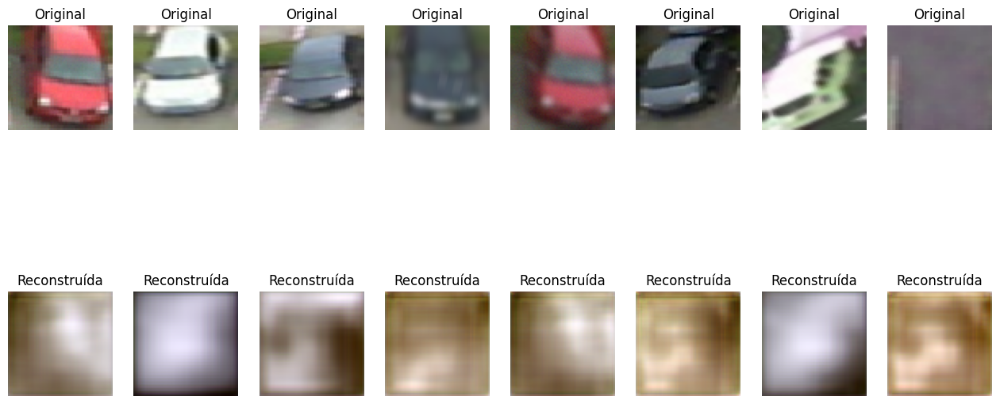

In [11]:
fine_tuning_modelos(treino_PUC, validacao_PUC, teste_PUC, nome_modelo=nome_Kyoto, nome_base='PUC', n_epocas=20, camadas=3, salvar=True)
limpa_memoria()

Fine Tuning UFPR04

I0000 00:00:1730995783.748747  710199 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730995784.346009  710199 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730995784.346231  710199 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730995784.347238  710199 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1849)           │     7,576,745 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     7,581,299 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,158,044 (57.82 MB)

 Trainable params: 15,158,044 (57.82 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


/home/lucas/PIBIC (copy)/.venv/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1730995788.979867  710303 service.cc:146] XLA service 0x7c354800a7e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1730995788.979891  710303 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce GTX 1660, Compute Capability 7.5
2024-11-07 13:09:49.017503: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-11-07 13:09:49.241067: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907


 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0341

I0000 00:00:1730995791.482836  710303 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - loss: 0.0341
Epoch 1: val_loss improved from -inf to 0.03075, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 294ms/step - loss: 0.0341 - val_loss: 0.0307
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0328
Epoch 2: val_loss did not improve from 0.03075
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0327 - val_loss: 0.0273
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0302
Epoch 3: val_loss did not improve from 0.03075
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0301 - val_loss: 0.0274
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0269
Epoch 4: val_loss did not improve from 0.03075
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0269 - val_loss: 0.0253
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0266
Epoch 5: val_loss did not improve from 0.03075
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0266 - val_loss: 0.0242
Ep

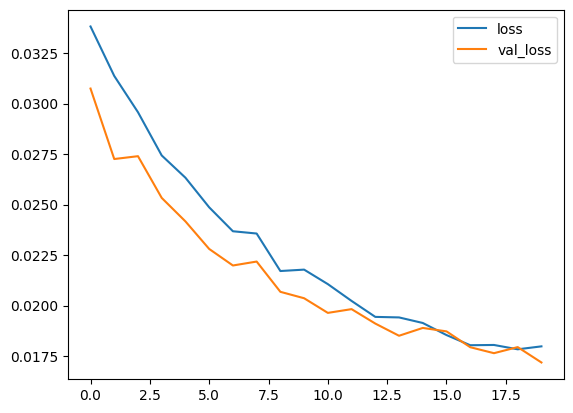

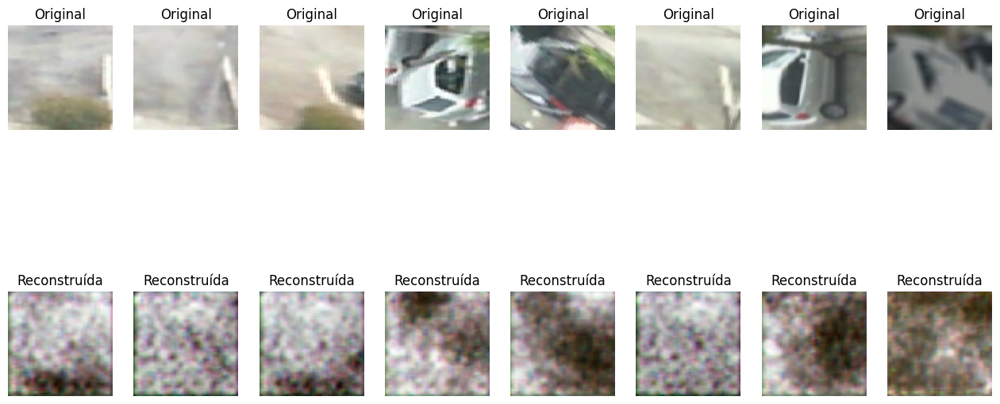

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 467)            │       983,227 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       994,027 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,977,254 (7.54 MB)

 Trainable params: 1,977,254 (7.54 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730995809.438261  710303 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995809.557556  710303 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 9/16 ━━━━━━━━━━━━━━━━━━━━ 2s 297ms/step - loss: 0.0448
Epoch 1: val_loss improved from -inf to 0.03722, saving model to Pesos_parciais/weights-improvement-01-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 299ms/step - loss: 0.0439 - val_loss: 0.0372
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0374
Epoch 2: val_loss did not improve from 0.03722
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0376 - val_loss: 0.0325
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0348
Epoch 3: val_loss did not improve from 0.03722
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0342 - val_loss: 0.0306
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0299
Epoch 4: val_loss did not improve from 0.03722
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0296 - val_loss: 0.0293
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0252
Epoch 5: val_loss did not improve from 0.03722
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0259 - val_loss: 0.0256
E

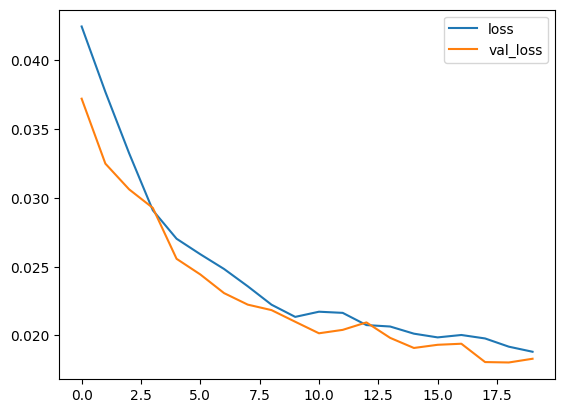

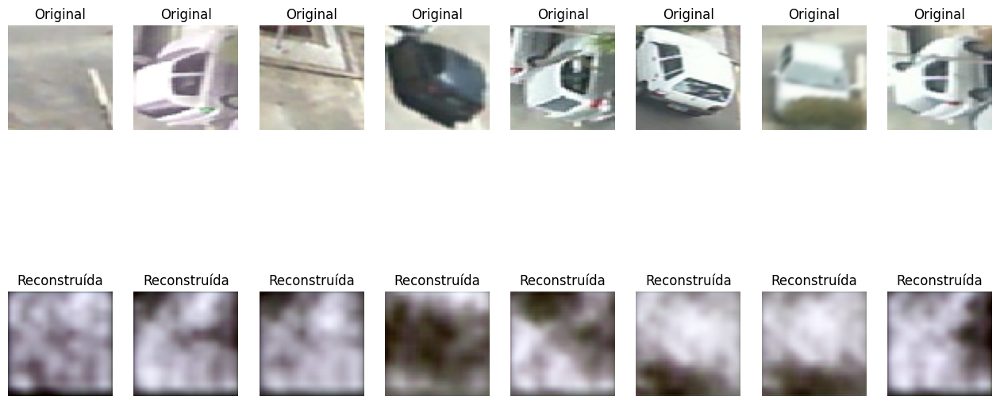

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 690)            │       161,866 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       161,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 323,749 (1.24 MB)

 Trainable params: 323,749 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730995829.759022  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995829.888710  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995830.493110  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995830.636988  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995830.778704  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 1/16 ━━━━━━━━━━━━━━━━━━━━ 2:01 8s/step - loss: 0.0483

E0000 00:00:1730995834.639696  710303 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995834.775996  710303 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995834.911828  710303 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - loss: 0.0415
Epoch 1: val_loss improved from -inf to 0.03289, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 464ms/step - loss: 0.0412 - val_loss: 0.0329
Epoch 2/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0349
Epoch 2: val_loss did not improve from 0.03289
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0348 - val_loss: 0.0310
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0330
Epoch 3: val_loss did not improve from 0.03289
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0329 - val_loss: 0.0304
Epoch 4/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0307
Epoch 4: val_loss did not improve from 0.03289
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0305 - val_loss: 0.0270
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0288
Epoch 5: val_loss did not improve from 0.03289
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0287 - val_loss: 0.0257
E

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


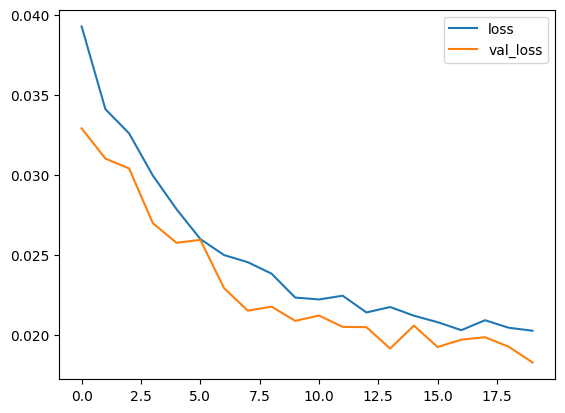

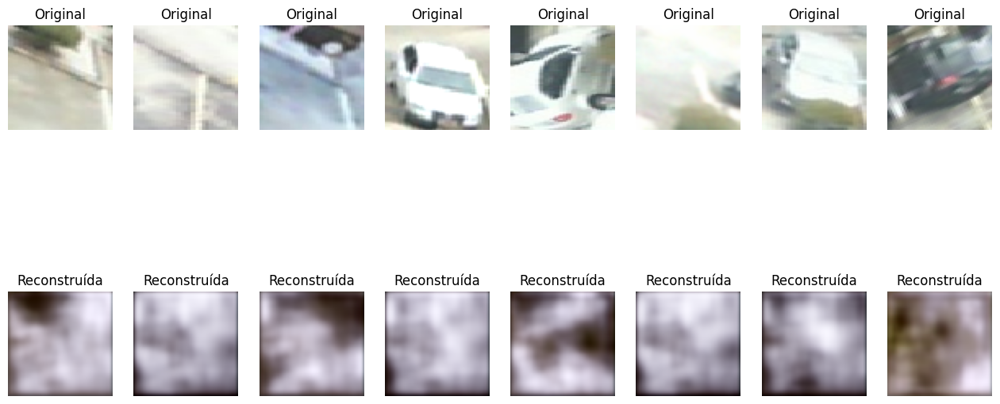

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1674)           │     3,433,234 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     3,434,187 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,867,421 (26.20 MB)

 Trainable params: 6,867,421 (26.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.0600 
Epoch 1: val_loss improved from -inf to 0.05724, saving model to Pesos_parciais/weights-improvement-01-0.06.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 239ms/step - loss: 0.0602 - val_loss: 0.0572
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0626
Epoch 2: val_loss did not improve from 0.05724
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0626 - val_loss: 0.0545
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0601
Epoch 3: val_loss improved from 0.05724 to 0.05951, saving model to Pesos_parciais/weights-improvement-03-0.06.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.0603 - val_loss: 0.0595
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0600
Epoch 4: val_loss did not improve from 0.05951
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0598 - val_loss: 0.0574
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0603
Epoch 5: val_loss did not improve fro

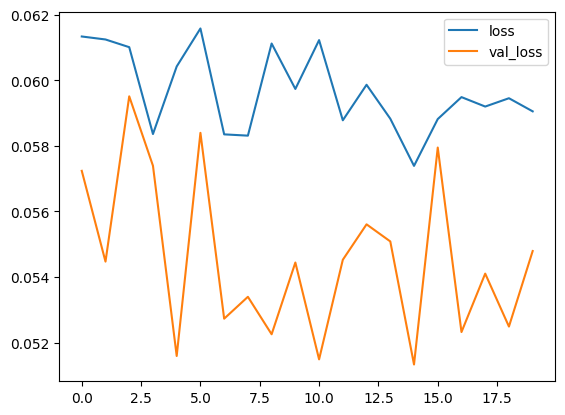

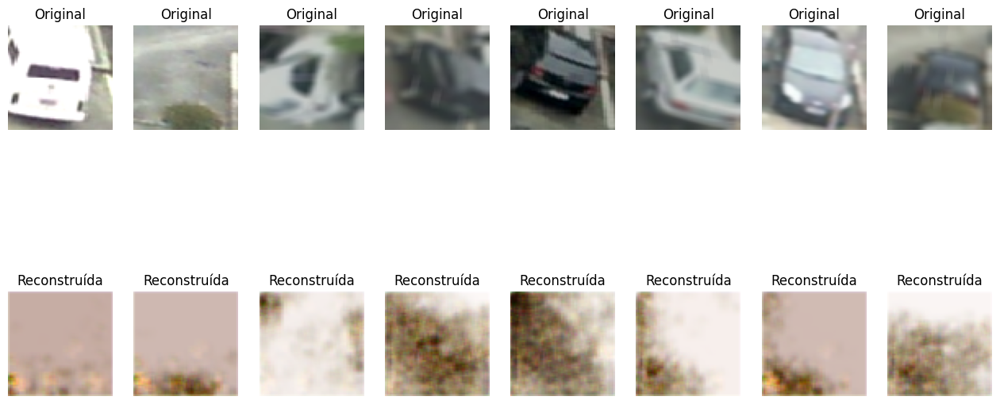

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 562)            │       213,714 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       215,523 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 429,237 (1.64 MB)

 Trainable params: 429,237 (1.64 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730995871.931027  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995872.053766  710300 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - loss: 0.0380
Epoch 1: val_loss improved from -inf to 0.03043, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 363ms/step - loss: 0.0378 - val_loss: 0.0304
Epoch 2/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0296
Epoch 2: val_loss did not improve from 0.03043
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0296 - val_loss: 0.0271
Epoch 3/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0274
Epoch 3: val_loss did not improve from 0.03043
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0275 - val_loss: 0.0279
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0273
Epoch 4: val_loss did not improve from 0.03043
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0272 - val_loss: 0.0250
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0249
Epoch 5: val_loss did not improve from 0.03043
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0250 - val_loss: 0.0250
E

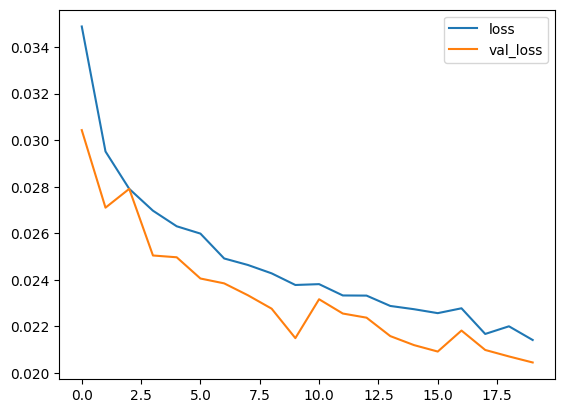

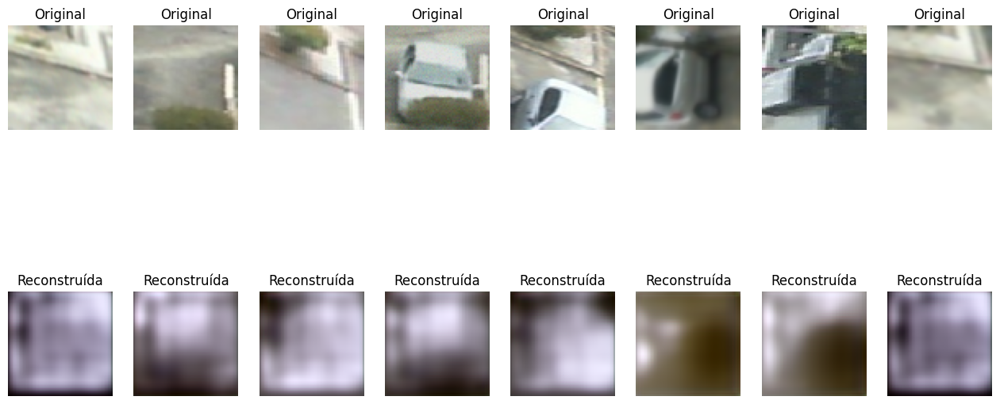

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 685)            │       379,637 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       380,043 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 759,680 (2.90 MB)

 Trainable params: 759,680 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
11/16 ━━━━━━━━━━━━━━━━━━━━ 1s 205ms/step - loss: 0.0291
Epoch 1: val_loss improved from -inf to 0.02320, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 8s 254ms/step - loss: 0.0286 - val_loss: 0.0232
Epoch 2/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0243
Epoch 2: val_loss did not improve from 0.02320
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0244 - val_loss: 0.0230
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0250
Epoch 3: val_loss did not improve from 0.02320
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0250 - val_loss: 0.0219
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0238
Epoch 4: val_loss did not improve from 0.02320
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0238 - val_loss: 0.0218
Epoch 5/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0221
Epoch 5: val_loss did not improve from 0.02320
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0222 - val_loss

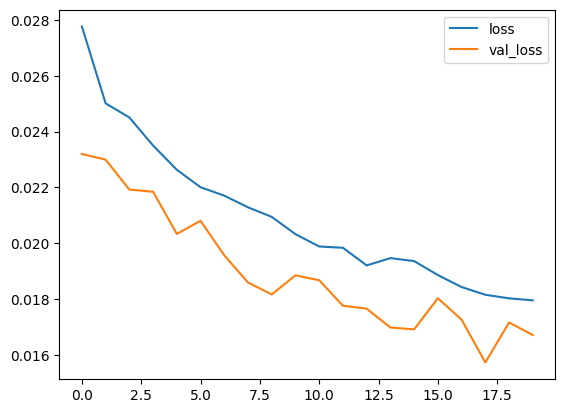

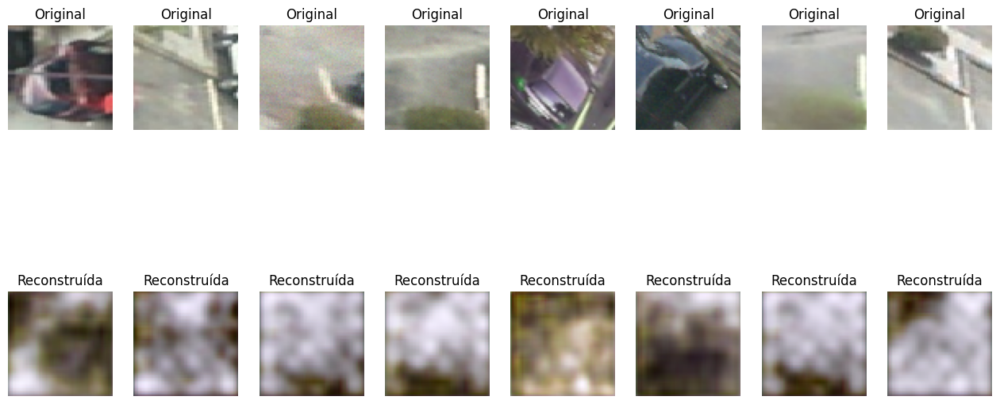

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1262)           │    20,687,598 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    20,739,587 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,427,185 (158.03 MB)

 Trainable params: 41,427,185 (158.03 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - loss: 0.0295
Epoch 1: val_loss improved from -inf to 0.02598, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 374ms/step - loss: 0.0292 - val_loss: 0.0260
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0245
Epoch 2: val_loss did not improve from 0.02598
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0245 - val_loss: 0.0215
Epoch 3/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0231
Epoch 3: val_loss did not improve from 0.02598
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0230 - val_loss: 0.0208
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0229
Epoch 4: val_loss did not improve from 0.02598
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0227 - val_loss: 0.0193
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0201
Epoch 5: val_loss did not improve from 0.02598
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0200 - val_loss

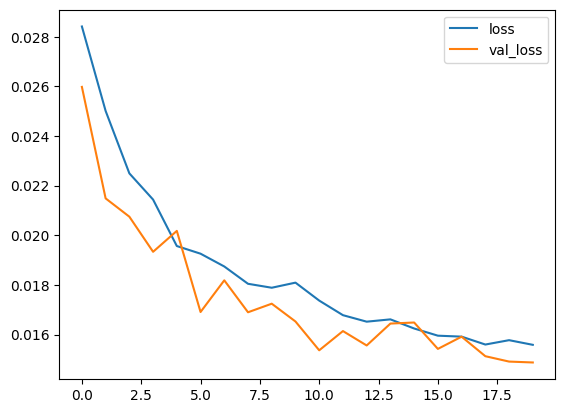

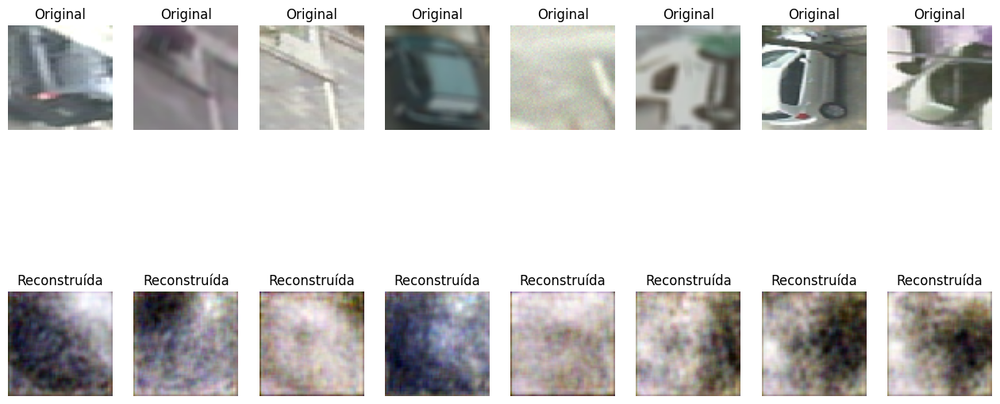

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1960)           │    32,159,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    32,176,435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 64,336,139 (245.42 MB)

 Trainable params: 64,336,139 (245.42 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730995936.624746  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995936.774245  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995937.267416  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995937.389397  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0561

E0000 00:00:1730995940.708781  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995940.852215  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730995940.996694  710298 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - loss: 0.0559
Epoch 1: val_loss improved from -inf to 0.05002, saving model to Pesos_parciais/weights-improvement-01-0.05.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 17s 744ms/step - loss: 0.0556 - val_loss: 0.0500
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0527
Epoch 2: val_loss improved from 0.05002 to 0.05013, saving model to Pesos_parciais/weights-improvement-02-0.05.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 674ms/step - loss: 0.0525 - val_loss: 0.0501
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0506
Epoch 3: val_loss did not improve from 0.05013
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - loss: 0.0509 - val_loss: 0.0496
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0514
Epoch 4: val_loss did not improve from 0.05013
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - loss: 0.0515 - val_loss: 0.0465
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.0484
Epoch 5: val_loss did not improve from 0.0501

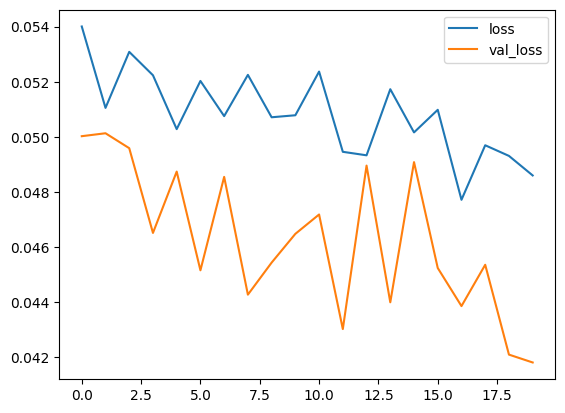

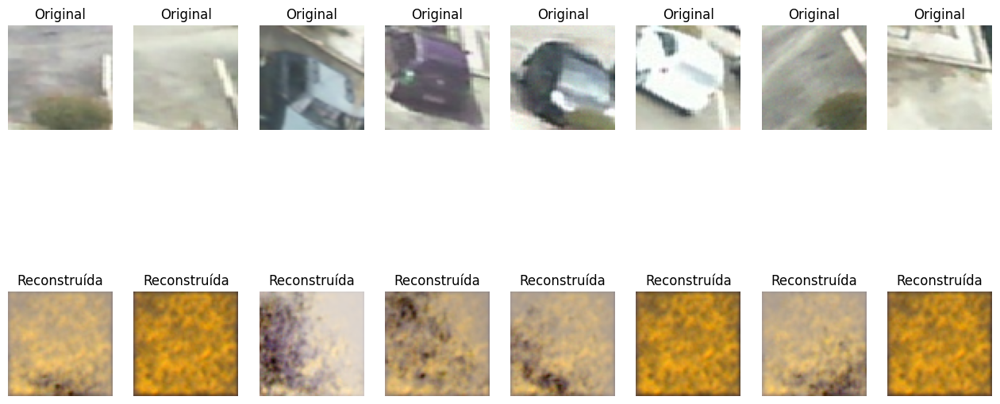

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 838)            │    27,536,070 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    27,715,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,251,529 (210.77 MB)

 Trainable params: 55,251,529 (210.77 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - loss: 0.0350
Epoch 1: val_loss improved from -inf to 0.02623, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - loss: 0.0348 - val_loss: 0.0262
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0289
Epoch 2: val_loss did not improve from 0.02623
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 0.0286 - val_loss: 0.0244
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0238
Epoch 3: val_loss did not improve from 0.02623
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0237 - val_loss: 0.0220
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0227
Epoch 4: val_loss did not improve from 0.02623
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 0.0226 - val_loss: 0.0195
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0206
Epoch 5: val_loss did not improve from 0.02623
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 0.0206 - val_loss: 

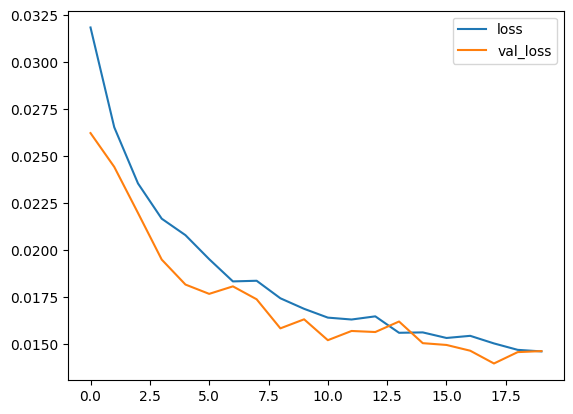

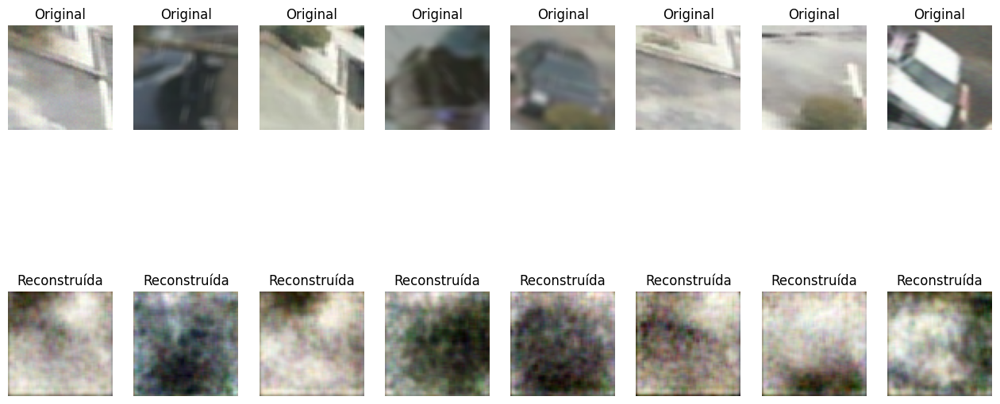

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 148)            │        41,532 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │        50,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,263 (360.40 KB)

 Trainable params: 92,263 (360.40 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - loss: 0.0490
Epoch 1: val_loss improved from -inf to 0.04155, saving model to Pesos_parciais/weights-improvement-01-0.04.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 274ms/step - loss: 0.0489 - val_loss: 0.0416
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0453
Epoch 2: val_loss did not improve from 0.04155
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0436 - val_loss: 0.0379
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0376
Epoch 3: val_loss did not improve from 0.04155
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0378 - val_loss: 0.0360
Epoch 4/20
10/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0376
Epoch 4: val_loss did not improve from 0.04155
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0370 - val_loss: 0.0343
Epoch 5/20
10/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0389
Epoch 5: val_loss did not improve from 0.04155
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0375 - val_los

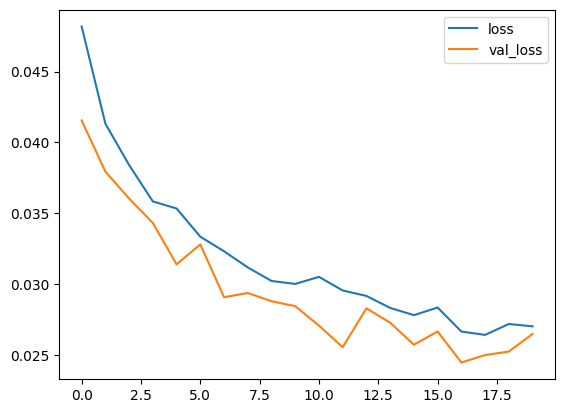

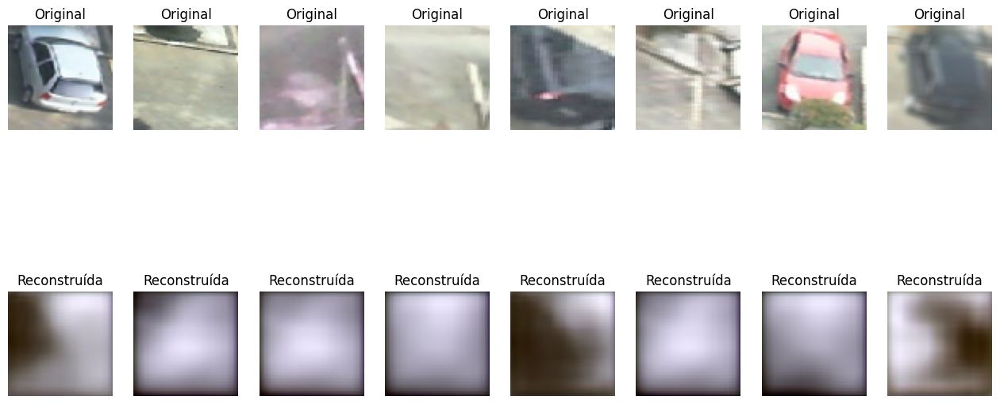

In [9]:
fine_tuning_modelos(treino_UFPR04, validacao_UFPR04, teste_UFPR04, nome_modelo=nome_Kyoto,nome_base='UFPR04', n_epocas=20, camadas=3, salvar=True, batch_size=8)
limpa_memoria()

Fine Tuning UFPR05

I0000 00:00:1730996573.792991  724443 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730996573.828497  724443 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730996573.828673  724443 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1730996573.829698  724443 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1849)           │     7,576,745 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     7,581,299 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,158,044 (57.82 MB)

 Trainable params: 15,158,044 (57.82 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


/home/lucas/PIBIC (copy)/.venv/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1730996576.832960  724544 service.cc:146] XLA service 0x71eb5400b9c0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1730996576.832978  724544 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce GTX 1660, Compute Capability 7.5
2024-11-07 13:22:56.869283: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-11-07 13:22:57.018791: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907


 1/16 ━━━━━━━━━━━━━━━━━━━━ 51s 3s/step - loss: 0.0221

I0000 00:00:1730996578.507529  724544 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


10/16 ━━━━━━━━━━━━━━━━━━━━ 1s 196ms/step - loss: 0.0238
Epoch 1: val_loss improved from -inf to 0.02269, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 8s 290ms/step - loss: 0.0237 - val_loss: 0.0227
Epoch 2/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0218
Epoch 2: val_loss improved from 0.02269 to 0.02290, saving model to Pesos_parciais/weights-improvement-02-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - loss: 0.0220 - val_loss: 0.0229
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0224
Epoch 3: val_loss did not improve from 0.02290
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0224 - val_loss: 0.0207
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0225
Epoch 4: val_loss did not improve from 0.02290
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0221 - val_loss: 0.0211
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0213
Epoch 5: val_loss did not improve from 0.02290
1

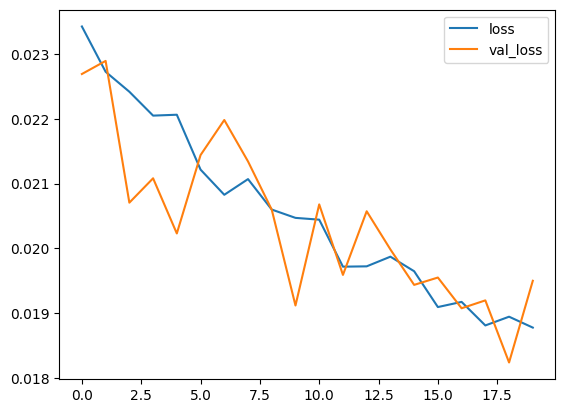

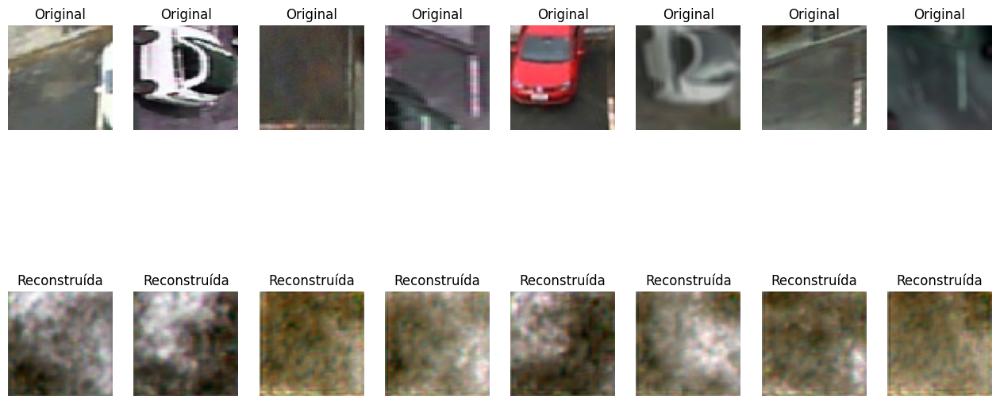

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 467)            │       983,227 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       994,027 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,977,254 (7.54 MB)

 Trainable params: 1,977,254 (7.54 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730996597.265736  724545 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996597.384629  724545 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - loss: 0.0238
Epoch 1: val_loss improved from -inf to 0.02272, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 296ms/step - loss: 0.0239 - val_loss: 0.0227
Epoch 2/20
 8/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0253
Epoch 2: val_loss did not improve from 0.02272
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0244 - val_loss: 0.0212
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0219
Epoch 3: val_loss did not improve from 0.02272
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0222 - val_loss: 0.0208
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0207
Epoch 4: val_loss did not improve from 0.02272
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0213 - val_loss: 0.0227
Epoch 5/20
 8/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0218
Epoch 5: val_loss did not improve from 0.02272
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0223 - val_loss: 0.0219
E

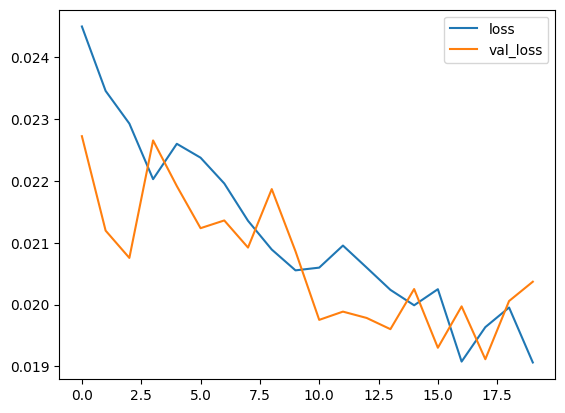

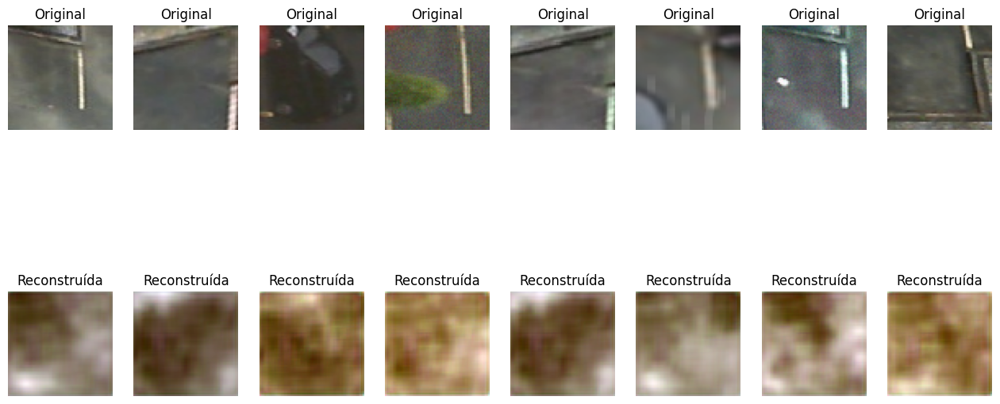

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 690)            │       161,866 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       161,883 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 323,749 (1.24 MB)

 Trainable params: 323,749 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730996617.912625  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996618.041059  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996618.523549  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996618.663377  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 4/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0258

E0000 00:00:1730996622.291671  724547 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996622.425953  724547 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step - loss: 0.0249
Epoch 1: val_loss improved from -inf to 0.02398, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 432ms/step - loss: 0.0248 - val_loss: 0.0240
Epoch 2/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0253
Epoch 2: val_loss did not improve from 0.02398
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0249 - val_loss: 0.0235
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0236
Epoch 3: val_loss did not improve from 0.02398
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0235 - val_loss: 0.0236
Epoch 4/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0212
Epoch 4: val_loss did not improve from 0.02398
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 0.0215 - val_loss: 0.0228
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0226
Epoch 5: val_loss did not improve from 0.02398
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0226 - val_loss: 0.0225
E

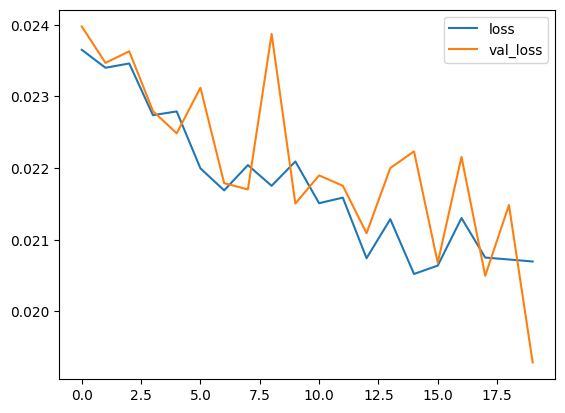

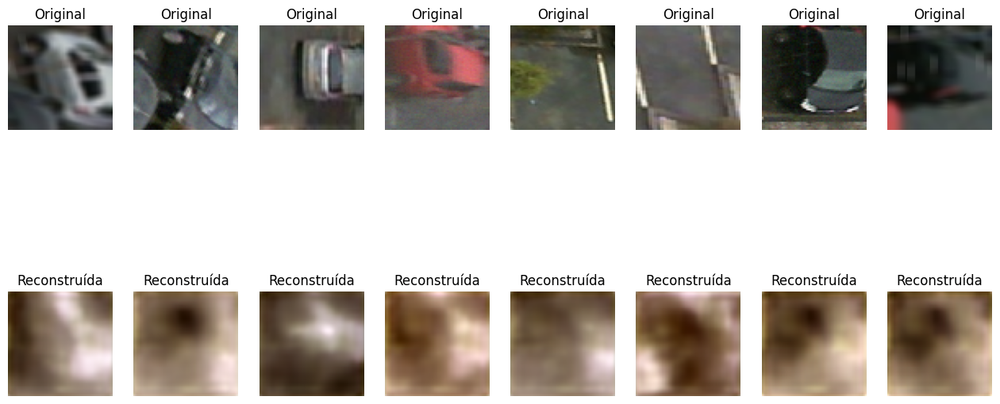

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1674)           │     3,433,234 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │     3,434,187 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,867,421 (26.20 MB)

 Trainable params: 6,867,421 (26.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 1s 151ms/step - loss: 0.0279
Epoch 1: val_loss improved from -inf to 0.02516, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 5s 178ms/step - loss: 0.0267 - val_loss: 0.0252
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0253
Epoch 2: val_loss did not improve from 0.02516
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0253 - val_loss: 0.0242
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0248
Epoch 3: val_loss did not improve from 0.02516
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 0.0248 - val_loss: 0.0239
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0220
Epoch 4: val_loss did not improve from 0.02516
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0229 - val_loss: 0.0250
Epoch 5/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0248
Epoch 5: val_loss did not improve from 0.02516
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0247 - val_loss

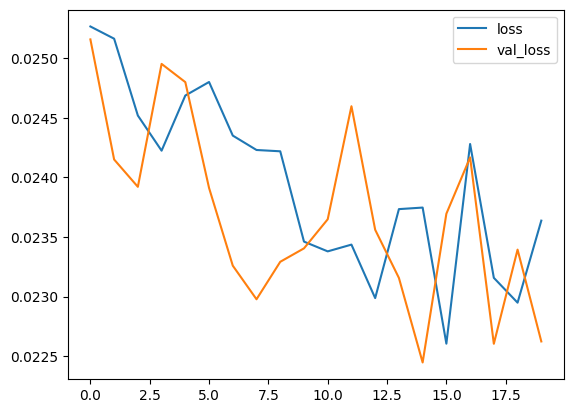

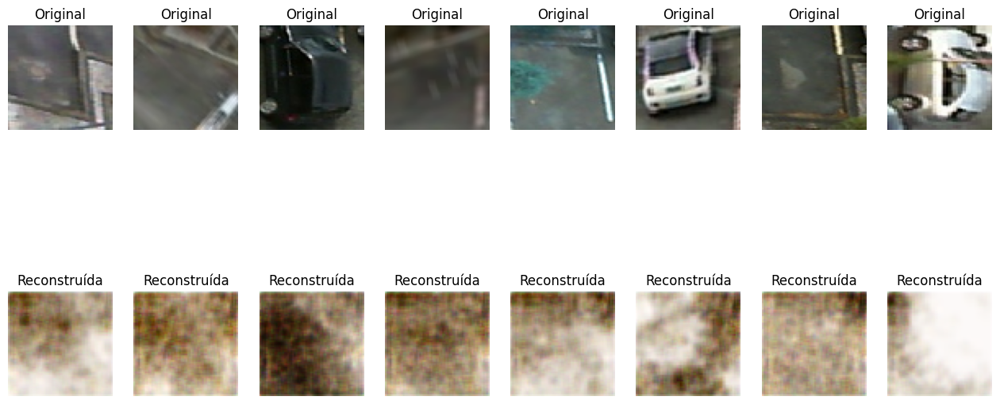

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 562)            │       213,714 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       215,523 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 429,237 (1.64 MB)

 Trainable params: 429,237 (1.64 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730996657.539478  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996657.661999  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - loss: 0.0259
Epoch 1: val_loss improved from -inf to 0.02544, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 345ms/step - loss: 0.0258 - val_loss: 0.0254
Epoch 2/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0256
Epoch 2: val_loss did not improve from 0.02544
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0254 - val_loss: 0.0231
Epoch 3/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0251
Epoch 3: val_loss did not improve from 0.02544
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0249 - val_loss: 0.0242
Epoch 4/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0238
Epoch 4: val_loss did not improve from 0.02544
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0239 - val_loss: 0.0232
Epoch 5/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0229
Epoch 5: val_loss did not improve from 0.02544
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0230 - val_loss: 0.0223
E

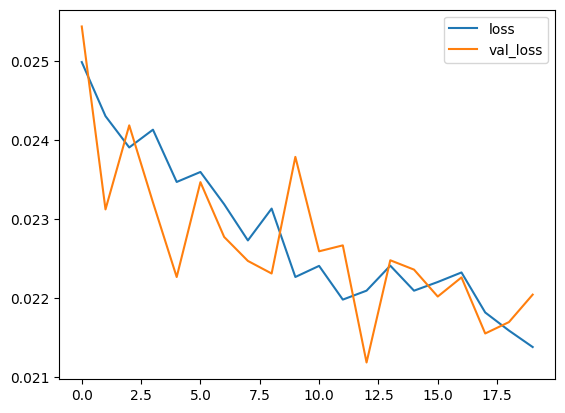

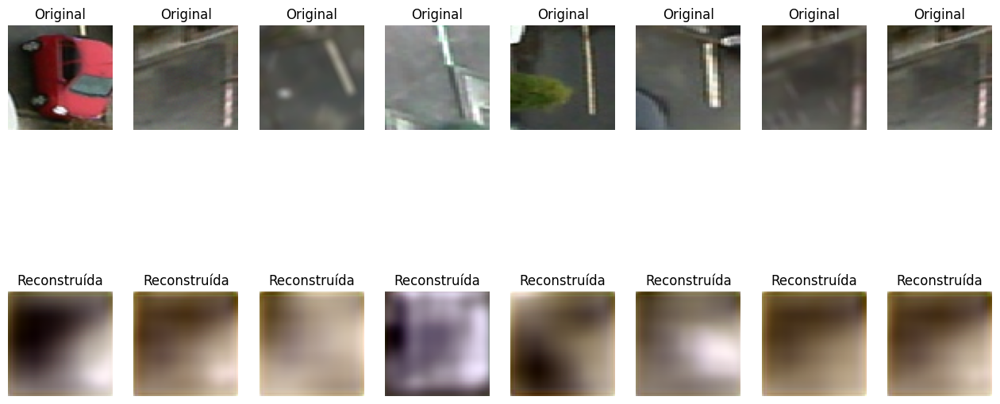

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 685)            │       379,637 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │       380,043 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 759,680 (2.90 MB)

 Trainable params: 759,680 (2.90 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 1s 244ms/step - loss: 0.0240
Epoch 1: val_loss improved from -inf to 0.02083, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 8s 240ms/step - loss: 0.0231 - val_loss: 0.0208
Epoch 2/20
10/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0200
Epoch 2: val_loss improved from 0.02083 to 0.02154, saving model to Pesos_parciais/weights-improvement-02-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 0.0203 - val_loss: 0.0215
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0206
Epoch 3: val_loss did not improve from 0.02154
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0206 - val_loss: 0.0203
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0194
Epoch 4: val_loss did not improve from 0.02154
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0195 - val_loss: 0.0212
Epoch 5/20
14/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0198
Epoch 5: val_loss did not improve fro

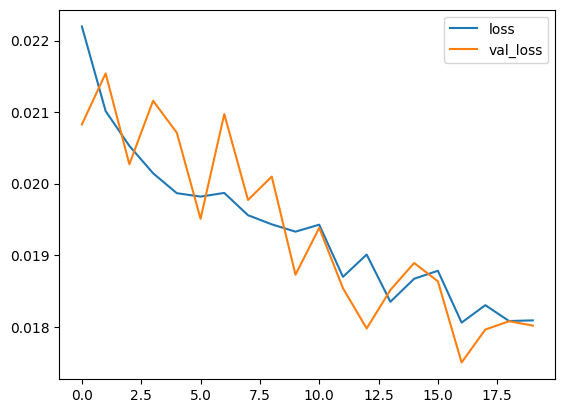

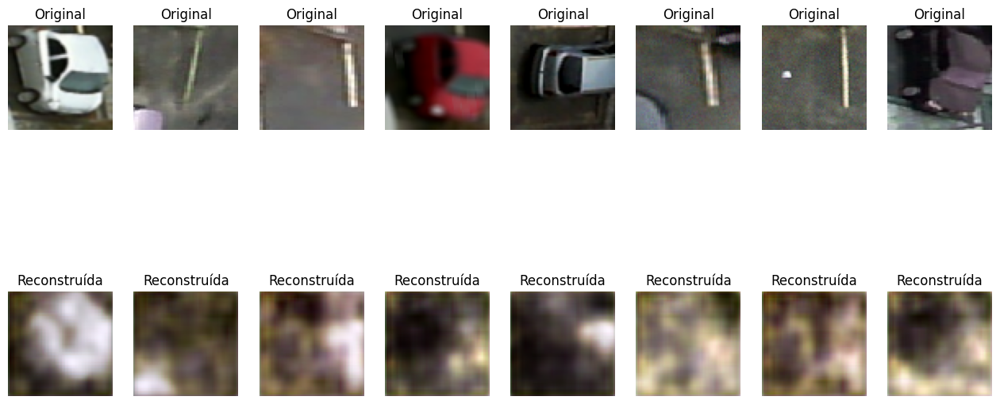

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1262)           │    20,687,598 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    20,739,587 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 41,427,185 (158.03 MB)

 Trainable params: 41,427,185 (158.03 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - loss: 0.0227
Epoch 1: val_loss improved from -inf to 0.02188, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 7s 293ms/step - loss: 0.0228 - val_loss: 0.0219
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0219
Epoch 2: val_loss did not improve from 0.02188
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 0.0219 - val_loss: 0.0213
Epoch 3/20
13/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0226
Epoch 3: val_loss did not improve from 0.02188
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0225 - val_loss: 0.0216
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0210
Epoch 4: val_loss did not improve from 0.02188
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0210 - val_loss: 0.0210
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0217
Epoch 5: val_loss did not improve from 0.02188
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.0217 - val_loss

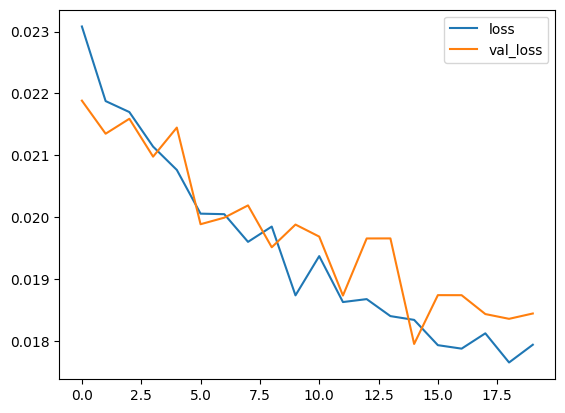

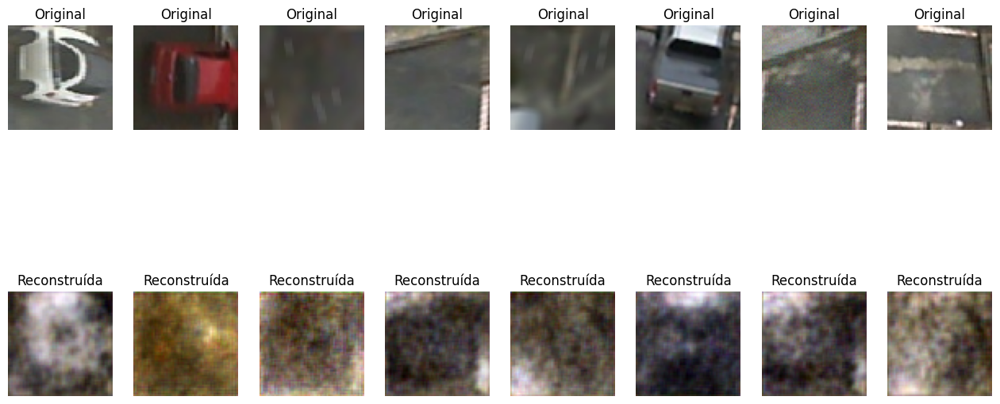

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 1960)           │    32,159,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    32,176,435 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 64,336,139 (245.42 MB)

 Trainable params: 64,336,139 (245.42 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1730996717.200971  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996717.348378  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996717.811672  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996717.933163  724546 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0238

E0000 00:00:1730996720.973793  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1730996721.115397  724543 gpu_timer.cc:183] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step - loss: 0.0243
Epoch 1: val_loss improved from -inf to 0.02487, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 649ms/step - loss: 0.0244 - val_loss: 0.0249
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0235
Epoch 2: val_loss did not improve from 0.02487
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - loss: 0.0236 - val_loss: 0.0245
Epoch 3/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0260
Epoch 3: val_loss did not improve from 0.02487
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - loss: 0.0258 - val_loss: 0.0245
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0259
Epoch 4: val_loss improved from 0.02487 to 0.02500, saving model to Pesos_parciais/weights-improvement-04-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - loss: 0.0257 - val_loss: 0.0250
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0235
Epoch 5: val_loss did not improve from 0.02500

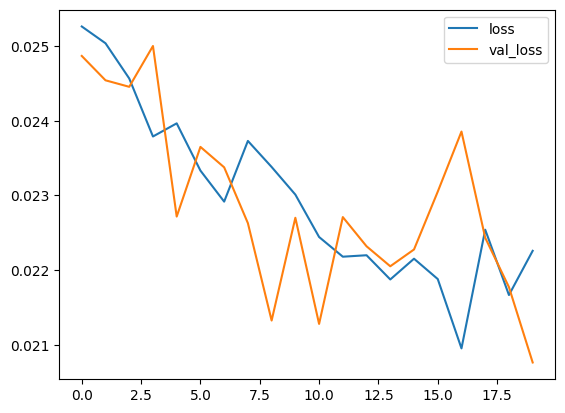

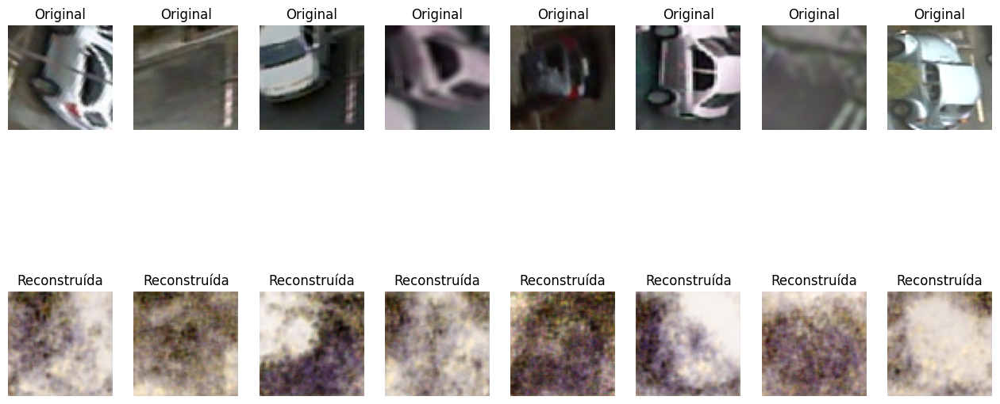

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 838)            │    27,536,070 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │    27,715,459 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,251,529 (210.77 MB)

 Trainable params: 55,251,529 (210.77 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - loss: 0.0245
Epoch 1: val_loss improved from -inf to 0.02275, saving model to Pesos_parciais/weights-improvement-01-0.02.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 61s 4s/step - loss: 0.0244 - val_loss: 0.0227
Epoch 2/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0225
Epoch 2: val_loss did not improve from 0.02275
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0225 - val_loss: 0.0223
Epoch 3/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0212
Epoch 3: val_loss did not improve from 0.02275
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - loss: 0.0213 - val_loss: 0.0215
Epoch 4/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0224
Epoch 4: val_loss did not improve from 0.02275
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - loss: 0.0223 - val_loss: 0.0198
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0214
Epoch 5: val_loss did not improve from 0.02275
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - loss: 0.0214 - val_loss: 

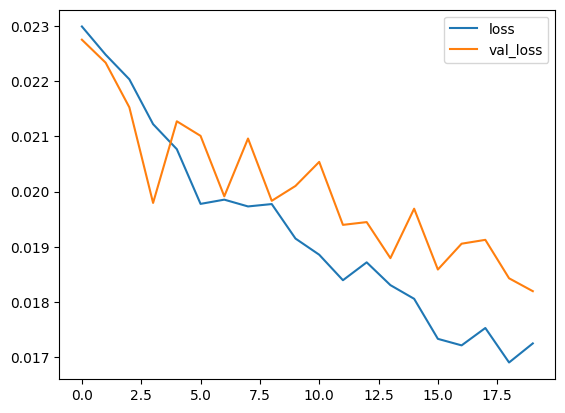

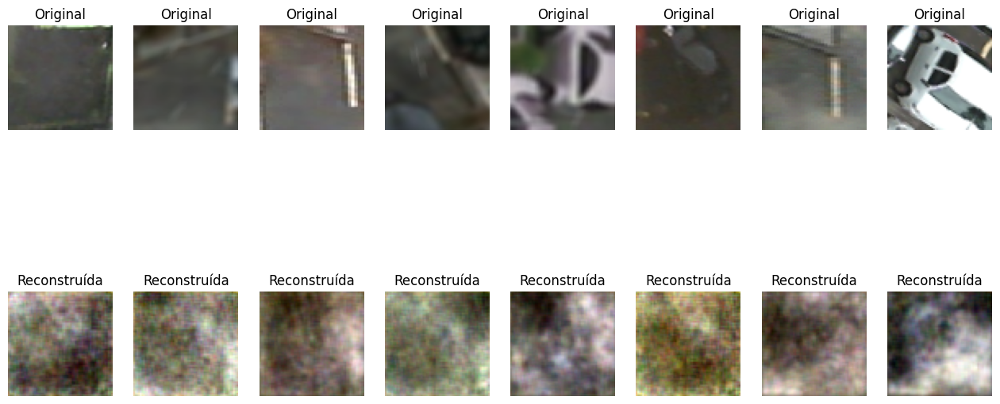

Model: "autoencoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ encoder (Functional)            │ (None, 148)            │        41,532 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ decoder (Functional)            │ (None, 64, 64, 3)      │        50,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,263 (360.40 KB)

 Trainable params: 92,263 (360.40 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - loss: 0.0273
Epoch 1: val_loss improved from -inf to 0.02636, saving model to Pesos_parciais/weights-improvement-01-0.03.weights.h5
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 311ms/step - loss: 0.0272 - val_loss: 0.0264
Epoch 2/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0263
Epoch 2: val_loss did not improve from 0.02636
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0259 - val_loss: 0.0254
Epoch 3/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0268
Epoch 3: val_loss did not improve from 0.02636
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0263 - val_loss: 0.0248
Epoch 4/20
 9/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0226
Epoch 4: val_loss did not improve from 0.02636
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0240 - val_loss: 0.0237
Epoch 5/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0256
Epoch 5: val_loss did not improve from 0.02636
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0256 - val_los

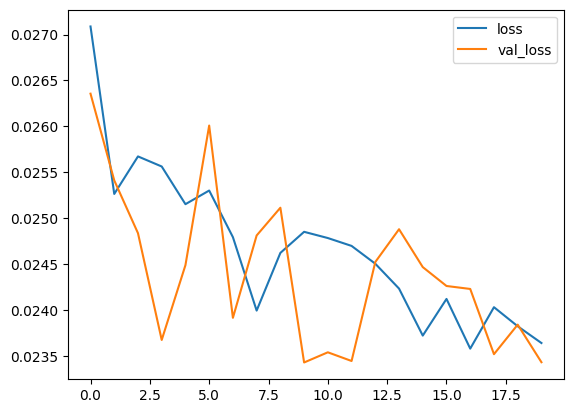

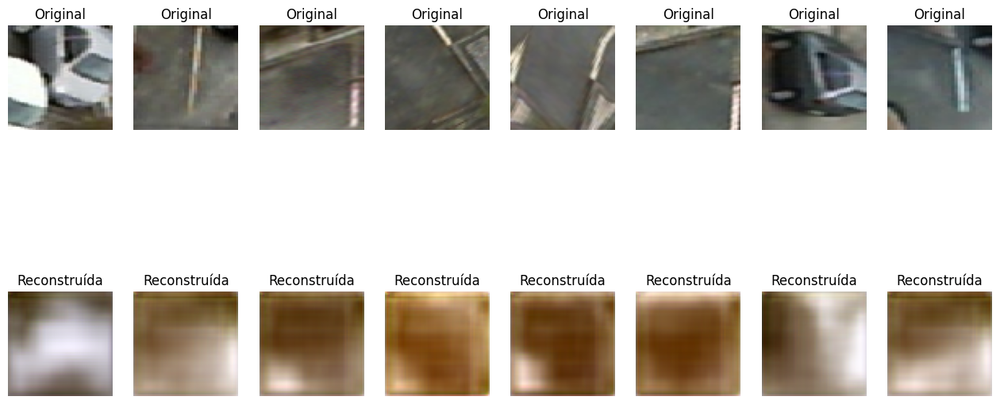

In [12]:
fine_tuning_modelos(treino_UFPR05, validacao_UFPR05, teste_UFPR05, nome_modelo = nome_Kyoto,nome_base='UFPR05', n_epocas=20, camadas=3, salvar=True)
limpa_memoria()